In [1]:
from matplotlib import pyplot as plt
import numpy as np
from obspy.clients.fdsn import Client
from obspy import UTCDateTime
from obspy import read_inventory
from obspy import Stream
from obspy.taup import TauPyModel
from obspy.geodetics import base
from obspy import read, read_inventory
# from obspyh5 import iterh5,writeh5,readh5
from obspy.signal.trigger import classic_sta_lta,plot_trigger,pk_baer

import os
import conda
import csv
from glob import glob
import pandas as pd

conda_file_dir = conda.__file__
conda_dir = conda_file_dir.split('lib')[0]
proj_lib = os.path.join(os.path.join(conda_dir, 'share'), 'proj')
os.environ["PROJ_LIB"] = proj_lib

from mpl_toolkits.basemap import Basemap
from mpl_toolkits.axes_grid1 import make_axes_locatable
from datetime import timedelta
import plotly.express as px
import matplotlib

matplotlib.rc('font', **{'size'   : 15})

from obspy.geodetics.base import gps2dist_azimuth
from obspy.geodetics import degrees2kilometers
import plotly.graph_objs as go
import datetime
import math
from matplotlib import gridspec

from CatalogFunctions import Catalog
import fiona

from matplotlib import colors
import matplotlib.patheffects as pe
from scipy.interpolate import make_interp_spline, BSpline
from obspy.imaging.beachball import beach

from sklearn.cluster import DBSCAN
import numpy as np

fiona.drvsupport.supported_drivers['kml'] = 'rw' # enable KML support which is disabled by default
fiona.drvsupport.supported_drivers['KML'] = 'rw' # enable KML support which is disabled by default

import geopandas as gpd
faults = gpd.read_file("../../Greece-2020-10-30/Altas/doc.kml")
# No. 1252:  Somas fault

full_sta = pd.read_csv('station.csv')

/home/tian_feng/anaconda3/lib/python3.7/site-packages/geopandas/geodataframe.py:422: RuntimeWarning: Sequential read of iterator was interrupted. Resetting iterator. This can negatively impact the performance.
  for feature in features_lst:


In [2]:
# df_VEL = pd.read_csv("Catalogs/df_VEL_Mw.csv")
# df_VEL.time=pd.to_datetime(df_VEL.time)
df_Hypo = pd.read_csv("Catalogs/df_Hypo_Mw3.csv")
df_Hypo =df_Hypo[df_Hypo['La']<38.1]
df_Hypo.index= range(len(df_Hypo))
df_Hypo.time=pd.to_datetime(df_Hypo.time)
df_Greek = pd.read_csv("Catalogs/df_NKUA.csv")
df_Greek.time=pd.to_datetime(df_Greek.time)


# df_VEL.Mw = df_VEL.Mw* 1.87089689518 -3.42138876455
df_Hypo.Mw = df_Hypo.Mw* 0.91 -0.48
# df_Hypo.Mw = df_Hypo.Mw* 0.89 -0.38

# df_Hypo.Mw = [3]*len(df_Hypo)
    
Hypo = Catalog(df_Hypo.copy(), full_sta, faults,'This study', None)
Greek = Catalog(df_Greek.copy(), full_sta, faults,'NKUA', None)

/home/tian_feng/UCLA/gMLP_phase/GreeceCase/CatalogFunctions.py:193: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df['Days'][i]=float(self.df['Days'][i]/ datetime.timedelta(days=1))


In [110]:
set(full_sta.channel)

{'HHE', 'HNE'}

In [106]:
df_Hypo[df_Hypo.Reloc==1]

,Unnamed: 0,Unnamed: 0.1,time,La,Lo,Dep,Mw,Reloc
2,2,2,2020-10-30 12:19:10.790,37.779517,26.451927,12.423,3.895676,1
5,5,5,2020-10-30 12:29:49.920,37.924919,26.930711,13.217,3.883903,1
6,6,6,2020-10-30 12:44:59.490,37.769971,26.451912,11.373,3.418274,1
7,7,7,2020-10-30 12:51:14.990,37.827938,26.309658,18.380,3.242654,1
10,10,10,2020-10-30 13:00:44.950,37.908244,26.835415,18.308,4.377280,1
...,...,...,...,...,...,...,...,...
530,535,535,2020-11-05 08:25:48.080,37.912520,26.570072,11.518,2.962646,1
532,537,537,2020-11-05 12:02:29.530,37.835596,26.882674,18.698,3.066877,1
534,539,539,2020-11-05 17:04:56.180,37.933378,26.913641,13.115,2.747854,1
538,543,543,2020-11-05 21:47:23.820,37.908134,26.602232,9.988,2.636631,1


In [13]:
dt=timedelta(seconds=3)
ds=30 # km
from math import radians, cos, sin, asin, sqrt


def haversine(s_lat, s_lng, e_lat, e_lng):

   # approximate radius of earth in km
   R = 6373.0

   s_lat = s_lat*np.pi/180.0                      
   s_lng = np.deg2rad(s_lng)     
   e_lat = np.deg2rad(e_lat)                       
   e_lng = np.deg2rad(e_lng)  

   d = np.sin((e_lat - s_lat)/2)**2 + np.cos(s_lat)*np.cos(e_lat) * np.sin((e_lng - s_lng)/2)**2

   return 2 * R * np.arcsin(np.sqrt(d))

def match_lists(t_JMA,t_new,La_JMA,La_new,Lo_JMA,Lo_new):
    #pbar = tqdm(total = len(t_JMA)+len(t_new)+1) 
    count=0
    i=j=0
    list_JMA=[]
    list_new=[]
    while (i<len(t_JMA) and j<len(t_new)):
        tmp_i=t_JMA[i]
        tmp_j=t_new[j]
        dis_ij=haversine(Lo_JMA[i],La_JMA[i],Lo_new[j],La_new[j])
#         if np.abs(tmp_i-tmp_j) <dt and dis_ij<ds and np.abs(Mw1[i]-Mw2[j])<=3:
        if np.abs(tmp_i-tmp_j) <dt and dis_ij<ds:

            #count=count+1
            list_JMA.append(i)
            list_new.append(j)
            #i=i+1
            j=j+1
        else:
            if tmp_i+dt>tmp_j:
                j=j+1
            else:
                i=i+1
                if j>5:
                    j=j-4
        #pbar.update(1) 
#     list_new=list(set(list_new))
    print("Totoal match events",len(list_new))
    print(str(len(list_JMA)))
    return list_JMA,list_new

def match_lists2(t_JMA,t_new,La_JMA,La_new,Lo_JMA,Lo_new):
    t_JMA = list(t_JMA)
    t_new = list(t_new)

    count=0
    i=j=0
    list_JMA=[]
    list_new=[]
    
    end = len(t_new)-1
    for i in range(len(t_JMA)) :
        tmp_i = t_JMA[i]
        
        start_j = min(range(len(t_new)), key=lambda k: abs(t_new[k]-tmp_i))
        left = right = start_j
        while t_new[left]>tmp_i-dt and left > 0 and t_new[left]<tmp_i+dt:
            left-=1
        while t_new[right]<tmp_i+dt and right < end and t_new[right]>tmp_i-dt:
            right+=1
#         print(left+1,start_j,right-1)
#         print(t_new[left+1],tmp_i,t_new[right-1])

        minval= ds+100
        tmp_out = None
        for j in range(left, right+1):
            dis_ij=haversine(Lo_JMA[i],La_JMA[i],Lo_new[j],La_new[j])
            if dis_ij < minval and abs(t_new[j]-tmp_i)<dt:
               tmp_out = j
               minval = dis_ij
        if minval<ds:
#             print(minval,abs(t_new[tmp_out]-tmp_i))
            list_JMA.append(i)
            list_new.append(tmp_out)
                
    print("Totoal match events",len(list_new))
    print(str(len(list_JMA)))
    return list_JMA,list_new



Totoal match events 165
165


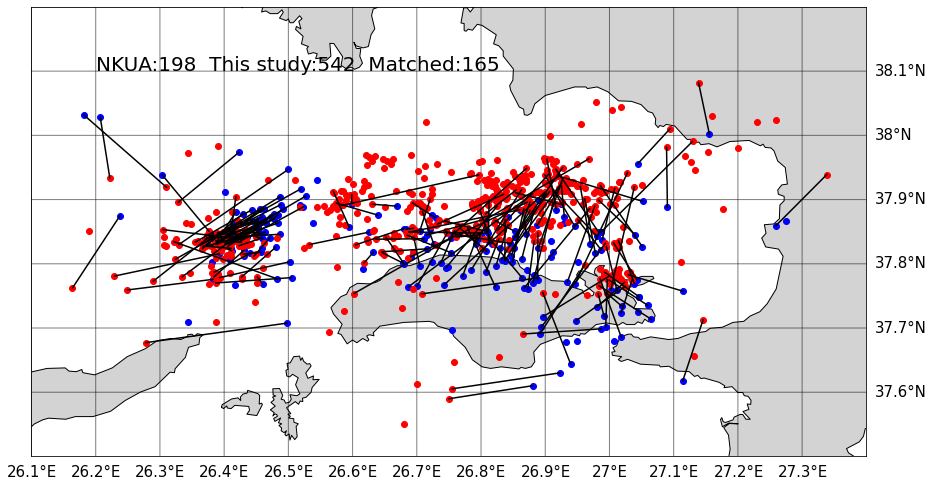

In [92]:


list_Greek,list_Hypo=match_lists2(df_Greek.time, df_Hypo.time,df_Greek.La,df_Hypo.La,df_Greek.Lo,df_Hypo.Lo)
plt.figure(figsize=(13,7))

map = Basemap(llcrnrlon=26.1,llcrnrlat=37.5,urcrnrlon=27.4,urcrnrlat=38.2,
         resolution='h') 

map.fillcontinents(color='lightgray',lake_color='white',zorder=1)
map.drawcoastlines()
parallels = np.arange(37.6,38.5,0.1)
# labels = [left,right,top,bottom]
map.drawparallels(parallels,labels=[False,True,True,False])
meridians = np.arange(26.0,27.5,0.1)
map.drawmeridians(meridians,labels=[True,False,False,True])

plt.plot(df_Greek.Lo,df_Greek.La,'bo')
plt.plot(df_Hypo.Lo,df_Hypo.La,'ro')
# plt.scatter(lon0,lat0,marker=(5, 1),s=1000)
for i in range(len(list_Greek)):
    plt.plot([df_Greek.Lo[list_Greek[i]],df_Hypo.Lo[list_Hypo[i]]],[df_Greek.La[list_Greek[i]],df_Hypo.La[list_Hypo[i]]],'k-')
plt.text(26.2,38.1,'NKUA:198  This study:'+str(len(df_Hypo)) + '  Matched:'+str(len(list_Greek)),fontsize=20)
plt.tight_layout()
plt.savefig('Figures/figureS3.png')

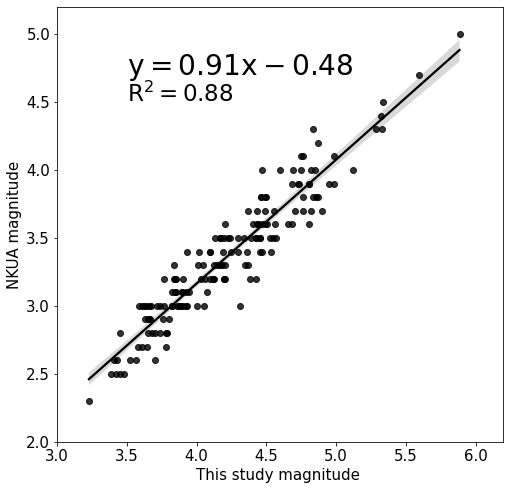

In [17]:
import seaborn as sns
from sklearn.metrics import r2_score
plt.figure(figsize=(8,8))

x,y = df_Hypo.Mw[list_Hypo], df_Greek.Mw[list_Greek]
P = np.polyfit (x,y,1)

sns.regplot(x,y, color ='black')
plt.xlim([3,6.2])
plt.ylim([2,5.2])
plt.text(3.5,4.7,'$\mathregular{y=%.2fx%.2f}$'%(P[0],P[1]),fontsize=28)
plt.text(3.5,4.5,'$\mathregular{R^2} = %.2f$'%(r2_score( P[0]*x+P[1], y)),fontsize=23)

plt.xlabel('This study magnitude ')
plt.ylabel('NKUA magnitude')
plt.savefig('Figures/FigS4.png')
plt.savefig('Figures/FigS4.pdf')

In [4]:

cat=df_Hypo
cat.Mw = cat.Mw*0.90-0.40
# df_Hypo.Mw = df_Hypo.Mw* 0.89 -0.38

x = []
for i in range(len(cat)):
    if cat.Lo[i] < 26.6:
        x.append(0)
    elif cat.Lo[i] < 26.76:
        x.append(1)
    elif cat.Lo[i] < 26.96:
        x.append(2)
    else:
        x.append(3)
cat['cluster'] = x
        
    

        

In [45]:
cat

,Unnamed: 0,Unnamed: 0.1,time,La,Lo,Dep,Mw,Reloc,cluster
0,0,0,2020-10-30 11:56:03.290,37.979599,26.563299,9.140,4.219727,0,-1
1,1,1,2020-10-30 11:58:06.700,37.923599,26.913900,27.390,4.324251,0,0
2,2,2,2020-10-30 12:45:00.390,37.792198,26.457399,16.220,3.452960,0,1
3,3,3,2020-10-30 13:00:44.570,37.922501,26.795200,19.100,4.427459,0,0
4,4,4,2020-10-30 13:06:58.480,37.897042,26.977657,15.632,3.951351,1,0
...,...,...,...,...,...,...,...,...,...
277,277,277,2020-11-05 12:40:08.040,37.926961,27.325657,7.848,3.667461,1,-1
278,278,278,2020-11-05 17:55:23.620,37.812099,26.817400,20.400,3.130985,0,0
279,279,279,2020-11-05 22:19:40.840,37.905448,26.859220,14.319,3.885431,1,0
280,280,280,2020-11-05 23:09:41.880,37.851101,26.627100,5.290,3.090636,0,0


6


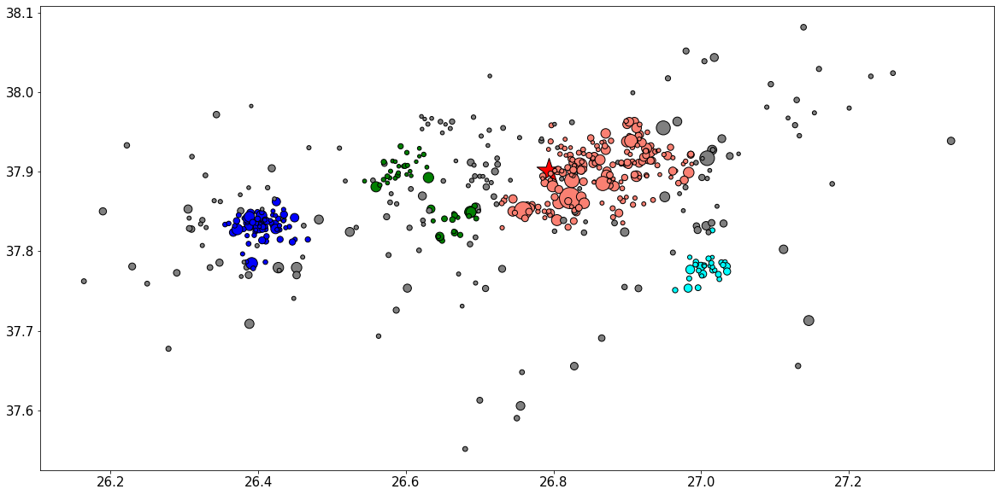

In [5]:

cat=df_Hypo

lat0=37.902    #37.897
lon0=26.794 #26.784
dep0=17 # 21

X = np.array(list(zip(cat.Lo*111,cat.La*111, cat.Dep)))
clustering = DBSCAN(eps=4, min_samples=20).fit(X)
clustering.labels_
cat['cluster'] = clustering.labels_

print(max(clustering.labels_)+2)

plt.figure(figsize=(20,10))
# for i in range(len(cat)):
#     if cat['cluster'][i]==0:
#         cat['cluster'][i]=1
#     elif cat['cluster'][i]==1:
#         cat['cluster'][i]=3
#     elif cat['cluster'][i]==2:
#         cat['cluster'][i]=1
#     elif cat['cluster'][i]==3:
#         cat['cluster'][i]=2
#     else:
#         continue

# cmap = colors.ListedColormap(['gray','blue', 'green','salmon','cyan','cyan'])
cmap = colors.ListedColormap(['gray','salmon', 'blue','cyan','green','green'])

plt.scatter(cat['Lo'],cat['La'],c=cat['cluster'],marker='o',s=  5**cat['Mw'], cmap=cmap,zorder=2, facecolors='none', edgecolors='k')

plt.scatter(lon0,lat0,marker='*',c='r',s= 900,edgecolors='k')

In [66]:
df_Hypo

,Unnamed: 0,Unnamed: 0.1,time,La,Lo,Dep,Mw,Reloc,cluster
0,0,0,2020-10-30 11:58:07.250,37.955399,26.948700,18.410,3.468543,0,-1
1,1,1,2020-10-30 12:17:22.050,37.708698,26.388000,17.240,2.949477,0,-1
2,2,2,2020-10-30 12:19:10.790,37.779517,26.451927,12.423,3.106109,1,-1
3,3,3,2020-10-30 12:22:51.040,37.963200,26.909500,14.350,2.878681,0,0
4,4,4,2020-10-30 12:29:13.430,38.043999,27.017799,10.660,2.778685,0,-1
...,...,...,...,...,...,...,...,...,...
537,542,542,2020-11-05 19:14:54.820,38.020302,27.229900,16.390,2.095568,0,-1
538,543,543,2020-11-05 21:47:23.820,37.908134,26.602232,9.988,1.972968,1,3
539,544,544,2020-11-05 22:19:41.000,37.915218,26.863039,12.295,3.066549,1,0
540,545,545,2020-11-05 23:09:41.440,37.851200,26.631599,14.550,2.345223,0,-1


In [ ]:
# lat0= 37.897 #37.902    #37.897
# lon0= 26.784 #26.794 #26.784
# dep0= 21 # 17 #21
lat0= 37.902    #37.897
lon0= 26.794 #26.784
dep0= 17 #21


# cmap = colors.ListedColormap(['blue', 'green','salmon','cyan' ])
# cmap = colors.ListedColormap(['gray','blue', 'green','salmon','cyan','green', ])
cmap = colors.ListedColormap(['gray','salmon', 'blue','cyan','green'])

cmap1 = colors.ListedColormap(['blue', 'green' ])
cmap2 = colors.ListedColormap(['salmon','cyan' ])

Lo = (cat.Lo - lon0) * 111.19492664455873
La = (cat.La - lat0) * 111.19492664455873

xl1 = [-50, 50]
xl2 = [-30, 30]


fig = plt.figure(figsize=(15,23))
gs = gridspec.GridSpec(ncols=2, nrows=3, height_ratios=[2.8,1.2,0.65],width_ratios=[1,1]) 

ax0 = plt.subplot(gs[1,:])
ax1 = plt.subplot(gs[2,0])
ax2 = plt.subplot(gs[2,1])
ax3 = plt.subplot(gs[0,:])

ax0.set_aspect('equal')
ax1.set_aspect('equal')
ax2.set_aspect('equal')
ax3.set_aspect('equal')

theta = -5 * np.pi/180

r = np.sqrt(Lo**2+La**2)
angle = np.zeros(len(La))
for i in range(len(angle)):
    angle[i] = math.atan2(La[i], Lo[i]) - theta
x = np.cos(angle) * r
y = np.sin(angle) * r
ax0.text(xl1[0], 0 ,chr(64+1),fontsize=22)

ax0.text(xl1[1]-3, 0 ,chr(64+1)+'\'',fontsize=22)

#         gs = gridspec.GridSpec(1, 2, width_ratios=[3, 1]) 
#         ax0 = plt.subplot(gs[0])
ax0.scatter(x,cat['Dep'],marker='o',s = 6.2**cat['Mw'], c=cat['cluster'] , cmap=cmap, facecolors='none', edgecolors='k',zorder=1)
ax0.scatter(0,dep0,marker='*', c='r',s=900, edgecolors='k',zorder=2)

ax0.set_xlim(xl1)
ax0.set_ylim([0,35])
ax0.invert_yaxis()
ax0.set_ylabel('Depth(km)')
ax0.set_xlabel('Distance(km)')


left = cat[(cat['cluster'] ==1) | (cat['cluster'] ==3) | (cat['cluster'] ==4) ].index
right = cat[(cat['cluster'] ==0) |(cat['cluster'] ==2)].index

ax1.scatter(y[left],cat['Dep'][left],marker='o',s = (6**cat['Mw'][left]), c=cat['cluster'][left], cmap=cmap1, facecolors='none', edgecolors='k',zorder=1)
ax1.scatter(0,dep0,marker='*', c='r',s=900, edgecolors='k',zorder=2)
ax1.set_xlim(xl2)

ax1.text(xl2[0], 0 ,'B',fontsize=22)
ax1.text(xl2[1]-1, 0 ,'B\'',fontsize=22)
ax1.set_ylim([0,25])
ax1.invert_yaxis()
ax1.set_ylabel('Depth(km)')
ax1.set_xlabel('Distance(km)')
ax1.set_title('Cluster 1&2')


ax2.scatter(y[right],cat['Dep'][right],marker='o',s = (6**cat['Mw'][right]), c=cat['cluster'][right], cmap=cmap2, facecolors='none', edgecolors='k')
ax2.scatter(0,dep0,marker='*', c='r',s=900, edgecolors='k')
ax2.set_xlim(xl2)

ax2.text(xl2[0], 0 ,'B',fontsize=22)
ax2.text(xl2[1]-1, 0 ,'B\'',fontsize=22)
ax2.set_ylim([0,25])
ax2.invert_yaxis()
ax2.set_xlabel('Distance(km)')
ax2.set_title('Cluster 3&4')

map = Basemap(llcrnrlon=26.15,llcrnrlat=37.5,urcrnrlon=27.35,urcrnrlat=38.4,
         resolution='h',ax=ax3) 

map.fillcontinents(color='lightgray',lake_color='white',zorder=1)
map.drawcoastlines()
parallels = np.arange(37.5,38.5,0.1)
# labels = [left,right,top,bottom]
map.drawparallels(parallels,labels=[True,False,True,False])
meridians = np.arange(26.1,27.4,0.1)
map.drawmeridians(meridians,labels=[True,False,False,True])

ax3.scatter(cat['Lo'],cat['La'],c=cat['cluster'],marker='o',s=  6**cat['Mw'],cmap=cmap,zorder=2, facecolors='none', edgecolors='k')
ax3.scatter(lon0,lat0,marker='*',c='r',s= 900,edgecolors='k')


i=0
center = [(lon0, lat0),(21.8,38.25),(23.93,38.25)]
degree = [-3 * np.pi/180, -3 * np.pi/180, 30 * np.pi/180]
degree[i] = theta
r = 50/111.1
r2 = 30/111.1
ax3.text(center[i][0]-r*np.cos(degree[i])-0.04,center[i][1]+r*np.sin(degree[i]),'A',color='k',fontsize=24)
ax3.text(center[i][0]+r*np.cos(degree[i])+0.03,center[i][1]-r*np.sin(degree[i]),'A\'',color='k',fontsize=24)
ax3.plot([center[i][0]-r*np.cos(degree[i]),center[i][0]+r*np.cos(degree[i])],[center[i][1]+r*np.sin(degree[i]),center[i][1]-r*np.sin(degree[i])],'k',lw = 2.5)
ax3.text(lon0+r2*np.sin(degree[i]),center[i][1]+r2*np.cos(degree[i])+0.01,'B\'',color='k',fontsize=24)
ax3.text(lon0-r2*np.sin(degree[i]),center[i][1]-r2*np.cos(degree[i])-0.02,'B',color='k',fontsize=24)
ax3.plot([center[i][0]+r2*np.sin(degree[i]),center[i][0]-r2*np.sin(degree[i])],[center[i][1]+r2*np.cos(degree[i]),center[i][1]-r2*np.cos(degree[i])],'k',lw = 2.5)


for i in range(len(faults.geometry)):
    ax3.plot(faults.geometry[i][0].xy[0],faults.geometry[i][0].xy[1],'gray')   
# highlight samos fualt
ax3.plot(faults.geometry[1252][0].xy[0],faults.geometry[1252][0].xy[1],'darkkhaki',lw=3)     

ax3.text(26.5,37.77,'1',color='blue',fontsize=40,weight=500,path_effects=[pe.withStroke(linewidth=4, foreground="k")])
ax3.text(26.65,37.8,'2',color='green',fontsize=40,weight=500,path_effects=[pe.withStroke(linewidth=4, foreground="k")])
ax3.text(26.85,37.99,'3',color='salmon',fontsize=40,weight=500,path_effects=[pe.withStroke(linewidth=4, foreground="k")])
ax3.text(27.03,37.97,'4',color='cyan',fontsize=40,weight=500,path_effects=[pe.withStroke(linewidth=4, foreground="k")])
ax3.text(26.20, 37.62,'Offshore North Samos Fault',color ='darkkhaki',fontsize=22,weight=300,rotation=18, rotation_mode='anchor')

from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes

axins = zoomed_inset_axes(ax3, 0.042, loc=2) # zoom = 6
map2 = Basemap(llcrnrlon=22,llcrnrlat=32,urcrnrlon=32,urcrnrlat=42.,
             resolution='h',ax=axins)

map2.etopo()
map2.drawcoastlines()
for i in range(len(faults.geometry)):
    plt.plot(faults.geometry[i][0].xy[0],faults.geometry[i][0].xy[1],'w',zorder=1)  
    
parallels = np.arange(31,43,2)
# labels = [left,right,top,bottom]
map2.drawparallels(parallels,labels=[False,True,True,False])
meridians = np.arange(19,33,2)
map2.drawmeridians(meridians,labels=[True,False,False,True])
# llcrnrlon=26.25,llcrnrlat=37.6,urcrnrlon=27.35,urcrnrlat=38.3


axins.plot([26.25,26.25,27.35,27.35,26.25],[37.6,38.4,38.4,37.6,37.6],'r',lw=3)
np1 = [-3.73, 3.96,-0.231, -1.07,0.257,-0.245]#[93, 61, -91]
beach1 = beach(np1, xy=(lon0, lat0), width=0.6)
axins.add_collection(beach1)
# ax.annotate("", xy=(20, 33), xytext=(0, 0),
#              arrowprops=dict(arrowstyle="->"))

axins.arrow(24.2, 32.5, 0, 1, head_width=0.6, head_length=0.6,width=0.3,fc='k', ec='k')
axins.arrow(31, 39, -1, -0.1, head_width=0.6, head_length=0.6,width=0.3,fc='k', ec='k')
axins.arrow(26, 37.2, -0.3, -0.8, head_width=0.6, head_length=0.6,width=0.3,fc='k', ec='k')
axins.text(24.5,32.8,'African Plate',c='r',fontsize=22)
axins.text(28.6,39.5,'Anatolian\nMicroplates',c='r',fontsize=22)
axins.text(23.9,36.6,'Aegean\nMicroplates',c='r',fontsize=22)
axins.plot([22,23,24,25,26,27,28,29,30],[36, 35.1, 34.3,34,33.9,34.3,34.8,35.5,35.8],'k-.',lw=3)
axins.plot(faults.geometry[1252][0].xy[0],faults.geometry[1252][0].xy[1],'yellow',lw=2.3)     



st = -35#-8.2#-1.8#-9.4 #-11
length=50/np.tan(43/180*np.pi)
ax1.plot([st+length,st],[0, 50],'gray',ls='-.',lw = 1.5)
ax2.plot([st+length,st],[0, 50],'gray',ls='-.',lw = 1.5)


st = -17#-8.2#-1.8#-9.4 #-11
length=50/np.tan(46/180*np.pi)
ax1.plot([st,st+length],[0, 50],'darkkhaki',lw = 3)
ax2.plot([st,st+length],[0, 50],'darkkhaki',lw = 3)

# st = -20#-11
# dp = 0 #15
# length1=(25-dp)/np.tan(46/180*np.pi)
# length2=dp/np.tan(84/180*np.pi)
# x1 = [st-length2,st,st+length1]
# y1 = [0,dp,25]
# ax1.plot(x1,y1,'darkkhaki',lw = 3)
# ax2.plot(x1,y1,'darkkhaki',lw = 3)

# st = -16.4
# dp = 0#17.2
# length1=(25-dp)/np.tan(46/180*np.pi)
# length2=dp/np.tan(84/180*np.pi)
# x1 = [st-length2,st,st+length1]
# y1 = [0,dp,25]
# ax2.plot(x1,y1,'darkkhaki',lw = 3)

# plt.tight_layout()
ax0.text(45, 30, 'c', color='white',fontsize=35,weight=500,path_effects=[pe.withStroke(linewidth=4, foreground="k")])
ax1.text(25, 22, 'd',color='white',fontsize=35,weight=500,path_effects=[pe.withStroke(linewidth=4, foreground="k")])
ax2.text(25, 22, 'e',color='white',fontsize=35,weight=500,path_effects=[pe.withStroke(linewidth=4, foreground="k")])
ax3.text(27.27, 37.55, 'b',color='white',fontsize=35,weight=500,path_effects=[pe.withStroke(linewidth=4, foreground="k")])
axins.text(31, 32.6, 'a',color='white',fontsize=35,weight=500,path_effects=[pe.withStroke(linewidth=4, foreground="k")])

plt.savefig('Figures/Fig_4.png')
plt.savefig('Figures/Fig_4.pdf')


In [140]:
cat

,Unnamed: 0,Unnamed: 0.1,time,La,Lo,Dep,Mw,Reloc,cluster
0,0,0,2020-10-30 11:58:07.250,37.955399,26.948700,18.410,3.468543,0,-1
1,1,1,2020-10-30 12:17:22.050,37.708698,26.388000,17.240,2.949477,0,-1
2,2,2,2020-10-30 12:19:10.790,37.779517,26.451927,12.423,3.106109,1,-1
3,3,3,2020-10-30 12:22:51.040,37.963200,26.909500,14.350,2.878681,0,0
4,4,4,2020-10-30 12:29:13.430,38.043999,27.017799,10.660,2.778685,0,-1
...,...,...,...,...,...,...,...,...,...
537,542,542,2020-11-05 19:14:54.820,38.020302,27.229900,16.390,2.095568,0,-1
538,543,543,2020-11-05 21:47:23.820,37.908134,26.602232,9.988,1.972968,1,3
539,544,544,2020-11-05 22:19:41.000,37.915218,26.863039,12.295,3.066549,1,0
540,545,545,2020-11-05 23:09:41.440,37.851200,26.631599,14.550,2.345223,0,-1


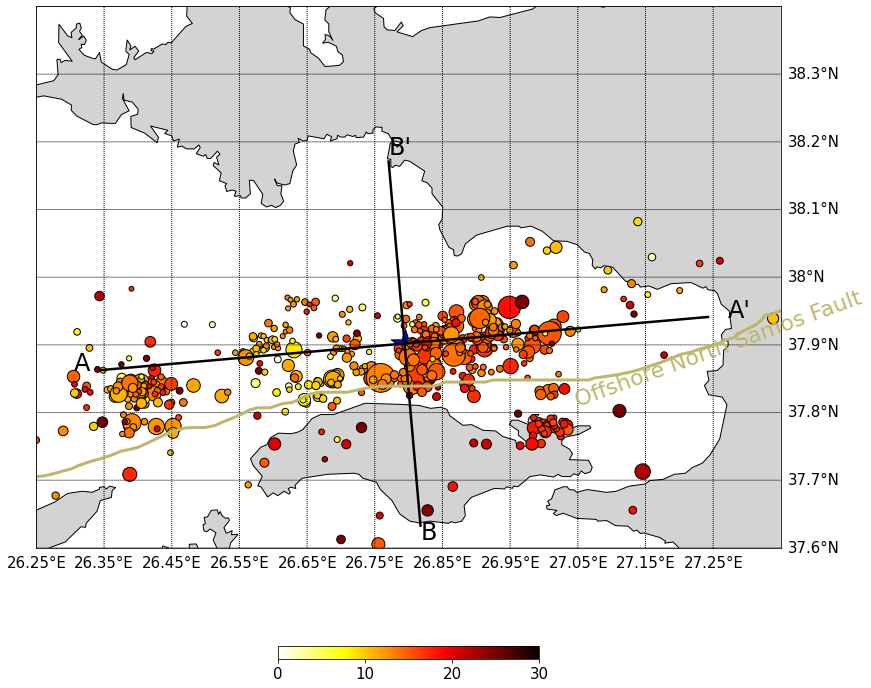

In [186]:
# lat0= 37.897 #37.902    #37.897
# lon0= 26.784 #26.794 #26.784
# dep0= 21 # 17 #21
lat0= 37.902    #37.897
lon0= 26.794 #26.784
dep0= 17 #21


# cmap = colors.ListedColormap(['blue', 'green','salmon','cyan' ])
# cmap = colors.ListedColormap(['gray','blue', 'green','salmon','cyan','green', ])
cmap = colors.ListedColormap(['gray','salmon', 'blue','cyan','green'])

cmap1 = colors.ListedColormap(['blue', 'green' ])
cmap2 = colors.ListedColormap(['salmon','cyan' ])

Lo = (cat.Lo - lon0) * 111.19492664455873
La = (cat.La - lat0) * 111.19492664455873

xl1 = [-50, 50]
xl2 = [-30, 30]


fig = plt.figure(figsize=(20,12))


theta = -5 * np.pi/180

r = np.sqrt(Lo**2+La**2)
angle = np.zeros(len(La))
for i in range(len(angle)):
    angle[i] = math.atan2(La[i], Lo[i]) - theta
x = np.cos(angle) * r
y = np.sin(angle) * r


cmap_reversed = matplotlib.cm.get_cmap('hot_r')


map = Basemap(llcrnrlon=26.25,llcrnrlat=37.6,urcrnrlon=27.35,urcrnrlat=38.4,
         resolution='h') 

map.fillcontinents(color='lightgray',lake_color='white',zorder=1)
map.drawcoastlines()
parallels = np.arange(37.6,38.5,0.1)
# labels = [left,right,top,bottom]
map.drawparallels(parallels,labels=[False,True,True,False])
meridians = np.arange(26.25,27.35,0.1)
map.drawmeridians(meridians,labels=[True,False,False,True])

plt.scatter(cat['Lo'],cat['La'],c=cat['Dep'],marker='o',s=  6**cat['Mw'],cmap=cmap_reversed,zorder=2, facecolors='none', edgecolors='k')
plt.colorbar(orientation="horizontal",fraction=0.02)
plt.clim(0, 30) 

plt.scatter(lon0,lat0,marker='*',c='b',s= 900,edgecolors='k')


i=0
center = [(lon0, lat0),(21.8,38.25),(23.93,38.25)]
degree = [-3 * np.pi/180, -3 * np.pi/180, 30 * np.pi/180]
degree[i] = theta
r = 50/111.1
r2 = 30/111.1
plt.text(center[i][0]-r*np.cos(degree[i])-0.04,center[i][1]+r*np.sin(degree[i]),'A',color='k',fontsize=24)
plt.text(center[i][0]+r*np.cos(degree[i])+0.03,center[i][1]-r*np.sin(degree[i]),'A\'',color='k',fontsize=24)
plt.plot([center[i][0]-r*np.cos(degree[i]),center[i][0]+r*np.cos(degree[i])],[center[i][1]+r*np.sin(degree[i]),center[i][1]-r*np.sin(degree[i])],'k',lw = 2.5)
plt.text(lon0+r2*np.sin(degree[i]),center[i][1]+r2*np.cos(degree[i])+0.01,'B\'',color='k',fontsize=24)
plt.text(lon0-r2*np.sin(degree[i]),center[i][1]-r2*np.cos(degree[i])-0.02,'B',color='k',fontsize=24)
plt.plot([center[i][0]+r2*np.sin(degree[i]),center[i][0]-r2*np.sin(degree[i])],[center[i][1]+r2*np.cos(degree[i]),center[i][1]-r2*np.cos(degree[i])],'k',lw = 2.5)


for i in range(len(faults.geometry)):
    ax3.plot(faults.geometry[i][0].xy[0],faults.geometry[i][0].xy[1],'gray')   
# highlight samos fualt
plt.plot(faults.geometry[1252][0].xy[0],faults.geometry[1252][0].xy[1],'darkkhaki',lw=3)     


plt.text(27.05, 37.81,'Offshore North Samos Fault',color ='darkkhaki',fontsize=22,weight=300,rotation=20, rotation_mode='anchor')

plt.savefig('Figures/figure12.png')
plt.savefig('Figures/figure12.pdf')


NameError: name 'Greek' is not defined

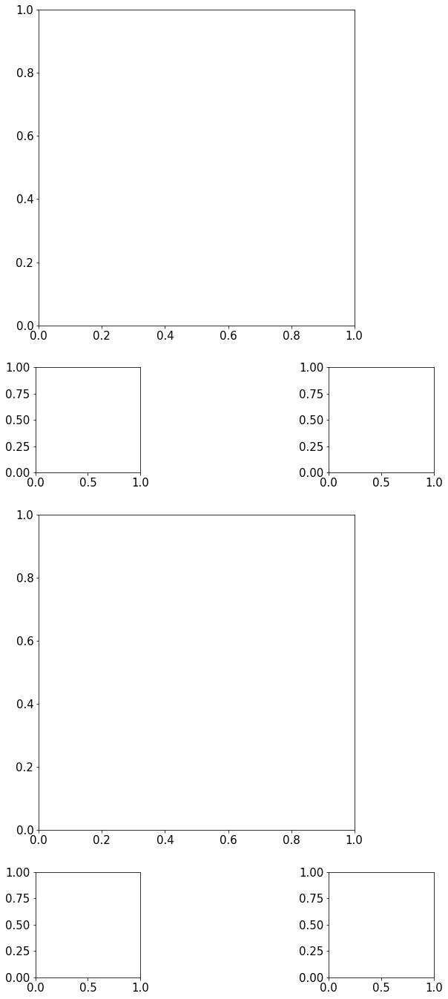

In [154]:
fig = plt.figure(figsize=(13,24))
gs = gridspec.GridSpec(ncols=2, nrows=4, height_ratios=[3,1,3,1], width_ratios=[2,1.05]) 

ax1 = plt.subplot(gs[0,:])
ax2 = plt.subplot(gs[1,0])
ax3 = plt.subplot(gs[1,1])
ax4 = plt.subplot(gs[2,:])
ax5 = plt.subplot(gs[3,0])
ax6 = plt.subplot(gs[3,1])


ax1.set_aspect('equal')
ax2.set_aspect('equal')
ax3.set_aspect('equal')
ax4.set_aspect('equal')
ax5.set_aspect('equal')
ax6.set_aspect('equal')

Greek.select_region(1)
Greek.plot_eq(True, ax=ax1)
Greek.plot_section(ax0 = ax2, ax1= ax3 )

Hypo.select_region(1)
Hypo.plot_eq(True, ax=ax4,colorBar=True)
Hypo.plot_section(ax0 = ax5, ax1= ax6)

plt.tight_layout()
plt.savefig('Figures/figure7.png')
plt.savefig('Figures/figure7.pdf')

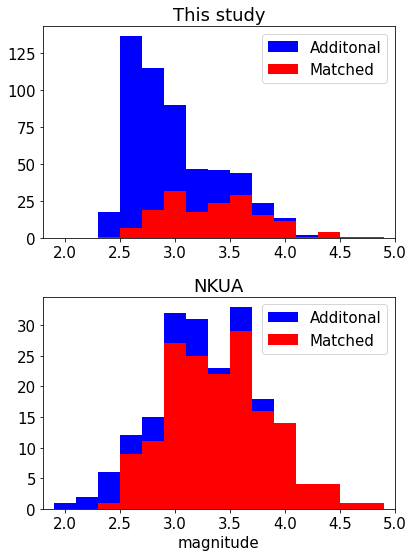

In [101]:
plt.figure(figsize=(6,8))
plt.subplot(211)
plt.hist(df_Hypo.Mw, bins=np.arange(1.5,5,0.2),color='b')

plt.hist(df_Hypo.Mw[list_Hypo], bins=np.arange(1.5,5,0.2),alpha=1,color='r')
plt.title('This study')
plt.xlim([1.8,5])
plt.legend(['Additonal','Matched'])
plt.subplot(212)

plt.hist(df_Greek.Mw, bins=np.arange(1.5,5,0.2),color='b')
plt.hist(df_Greek.Mw[list_Greek], bins=np.arange(1.5,5,0.2),alpha=1,color='r')
plt.title('NKUA')
plt.xlim([1.8,5])
plt.xlabel('magnitude')
plt.legend(['Additonal','Matched'])
plt.tight_layout()
plt.savefig('Figures/FigS5.png')
plt.savefig('Figures/FigS5.pdf')

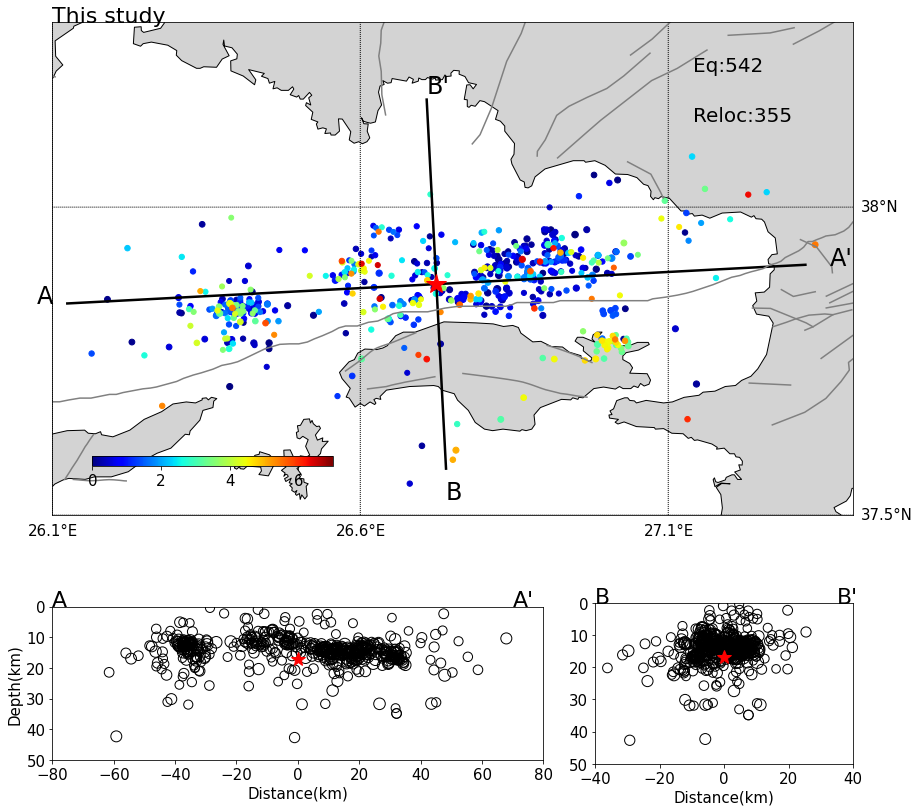

In [3]:
fig = plt.figure(figsize=(13,12))
gs = gridspec.GridSpec(ncols=2, nrows=2, height_ratios=[3,1], width_ratios=[2,1.05]) 

ax1 = plt.subplot(gs[0,:])
ax2 = plt.subplot(gs[1,0])
ax3 = plt.subplot(gs[1,1])


ax1.set_aspect('equal')
ax2.set_aspect('equal')
ax3.set_aspect('equal')


Hypo.select_region(1)
Hypo.plot_eq(True, ax=ax1,colorBar=True)
Hypo.plot_section(ax0 = ax2, ax1= ax3)

plt.tight_layout()
plt.savefig('Figures/Fig_S7.png')
plt.savefig('Figures/Fig_S7.pdf')

/home/tian_feng/UCLA/gMLP_phase/GreeceCase/CatalogFunctions.py:193: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df['Days'][i]=float(self.df['Days'][i]/ datetime.timedelta(days=1))


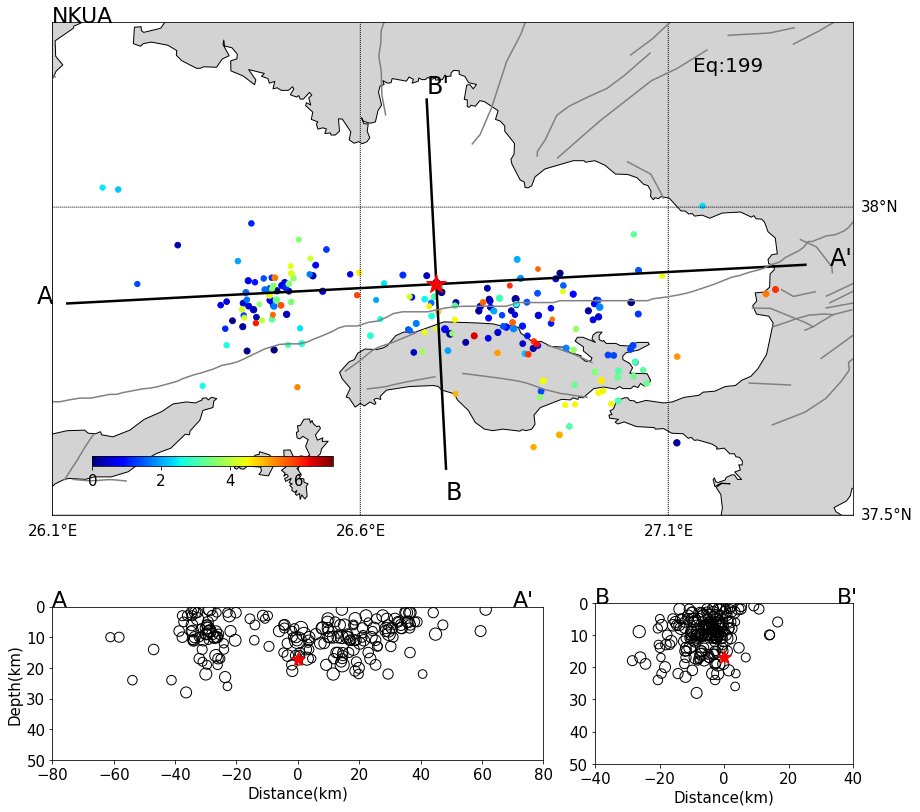

In [4]:
fig = plt.figure(figsize=(13,12))
gs = gridspec.GridSpec(ncols=2, nrows=2, height_ratios=[3,1], width_ratios=[2,1.05]) 

ax1 = plt.subplot(gs[0,:])
ax2 = plt.subplot(gs[1,0])
ax3 = plt.subplot(gs[1,1])
# ax4 = plt.subplot(gs[2,:])
# ax5 = plt.subplot(gs[3,0])
# ax6 = plt.subplot(gs[3,1])


ax1.set_aspect('equal')
ax2.set_aspect('equal')
ax3.set_aspect('equal')
# ax4.set_aspect('equal')
# ax5.set_aspect('equal')
# ax6.set_aspect('equal')

Greek.select_region(1)
Greek.plot_eq(True, ax=ax1, colorBar=True)
Greek.plot_section(ax0 = ax2, ax1= ax3 )

# Hypo.select_region(1)
# Hypo.plot_eq(True, ax=ax4,colorBar=True)
# Hypo.plot_section(ax0 = ax5, ax1= ax6)

plt.tight_layout()
plt.savefig('Figures/Fig_S6.png')
plt.savefig('Figures/Fig_S6.pdf')

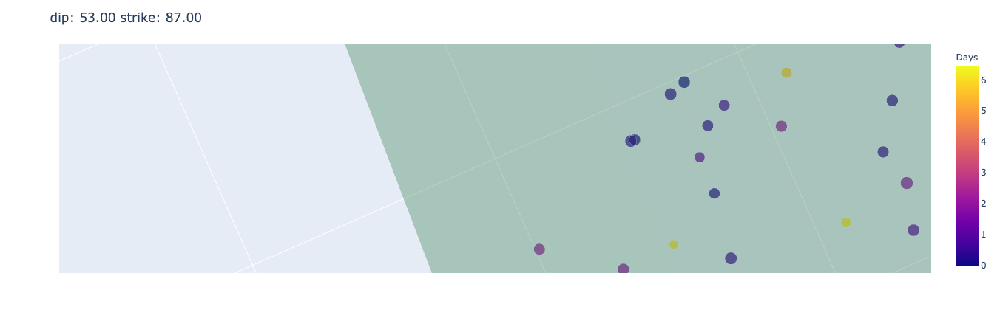

In [178]:
Greek.select_region(1)
Greek.plot_3d(color='Days')

/home/tian_feng/UCLA/gMLP_phase/GreeceCase/CatalogFunctions.py:193: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.df['Days'][i]=float(self.df['Days'][i]/ datetime.timedelta(days=1))


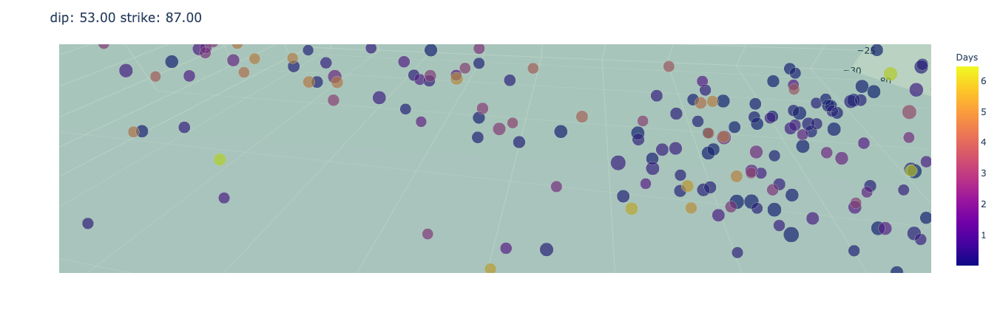

In [84]:
Hypo.select_region(1)
Hypo.plot_3d(color='Days')

In [132]:
dicts=set()
s=glob('Data2/*/*.npy')
for i in s:
#     i.split('/')[2]
    dicts.add(    i.split('/')[2])

In [160]:
countP=0
countS=0
files= sorted(glob('REAL_result2/catalog_sel_20201*'))[:7]
for file in files:
    with open(file) as f:
        s=f.readlines()
        for l in s:
            k=l.split()
            countP+=int(k[12])
            countS+=int(k[13])
        
print(countP,countS)

3450 1074


In [178]:
full_sta

,Unnamed: 0,client,network,station,latitude,longitude,depth,channel
0,0,KOERI,KO,EDC,40.34650,27.86180,257.0,HHE
1,1,KOERI,KO,EZN,39.82550,26.32470,48.0,HHE
2,2,KOERI,KO,GEDZ,39.04450,29.41050,883.0,HHE
3,3,KOERI,KO,GELI,40.39800,26.47420,126.0,HHE
4,4,KOERI,KO,KRBG,40.39320,27.29770,79.0,HHE
...,...,...,...,...,...,...,...,...
67,67,NOA,HA,VILL,38.16420,23.31220,650.0,HHE
68,68,NOA,HA,ATHU,37.96650,23.78450,308.0,HHE
69,69,NOA,HA,KARY,38.03210,24.43700,220.0,HHE
70,70,NOA,HA,MDRA,38.06060,23.46620,370.0,HHE


671
conti_data/20201101/1h/HL_APE.mseed
conti_data/20201101/1h/HT_CHOS.mseed
conti_data/20201101/1h/HL_EAG2.mseed
conti_data/20201101/1h/KO_CESE.mseed
conti_data/20201101/1h/KO_KRBN.mseed
conti_data/20201101/1h/KO_GMLD.mseed
conti_data/20201101/1h/HI_KRL1.mseed
1633
conti_data/20201101/1h/HT_CHOS.mseed
conti_data/20201101/1h/HL_EAG2.mseed
conti_data/20201101/1h/KO_KRBN.mseed
conti_data/20201101/1h/KO_FOCM.mseed
conti_data/20201101/1h/KO_GMLD.mseed
conti_data/20201101/1h/HI_KRL1.mseed
1873
conti_data/20201101/1h/HL_NPS.mseed
conti_data/20201101/1h/HL_THERA.mseed
conti_data/20201101/1h/HT_CHOS.mseed
conti_data/20201101/1h/HL_EAG2.mseed
conti_data/20201101/1h/HL_PRK.mseed
conti_data/20201101/1h/HI_KRL1.mseed
conti_data/20201101/1h/KO_SOMA.mseed
conti_data/20201101/1h/KO_KHL.mseed
conti_data/20201101/1h/KO_YKAV.mseed
1958
conti_data/20201101/1h/HT_CHOS.mseed
conti_data/20201101/1h/HL_EAG2.mseed
conti_data/20201101/1h/KO_KRBN.mseed
conti_data/20201101/1h/HI_MYT1.mseed
conti_data/20201101/1h

/home/tian_feng/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


13917
conti_data/20201101/4h/HI_SIT2.mseed
conti_data/20201101/4h/HL_NPS.mseed
conti_data/20201101/4h/HA_VILL.mseed
conti_data/20201101/4h/HT_ALN.mseed
conti_data/20201101/4h/KO_GMLD.mseed
conti_data/20201101/4h/HI_KRL1.mseed
14090
conti_data/20201101/4h/HL_DION.mseed
conti_data/20201101/4h/HT_AOS2.mseed
conti_data/20201101/4h/HT_CHOS.mseed
conti_data/20201101/4h/HT_THAS.mseed
conti_data/20201101/4h/KO_SOMA.mseed
conti_data/20201101/4h/KO_GMLD.mseed
conti_data/20201101/4h/KO_APMY.mseed
conti_data/20201101/4h/HI_KRL1.mseed
16173
conti_data/20201101/5h/HL_DION.mseed
conti_data/20201101/5h/HT_CHOS.mseed
conti_data/20201101/5h/HL_EAG2.mseed
conti_data/20201101/5h/KO_GELI.mseed
conti_data/20201101/5h/KO_SOMA.mseed
conti_data/20201101/5h/KO_GMLD.mseed
conti_data/20201101/5h/HI_KRL1.mseed
16738
conti_data/20201101/5h/HA_SNT5.mseed
conti_data/20201101/5h/KO_FOCM.mseed
conti_data/20201101/5h/HL_LIA.mseed
conti_data/20201101/5h/HL_PRK.mseed
conti_data/20201101/5h/KO_EZN.mseed
conti_data/20201101

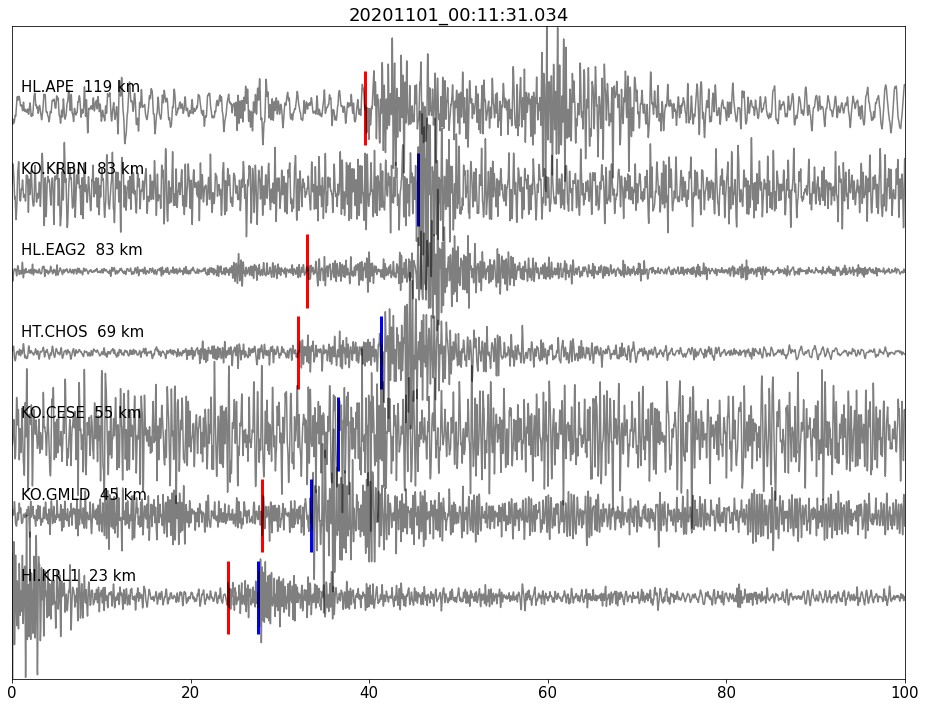

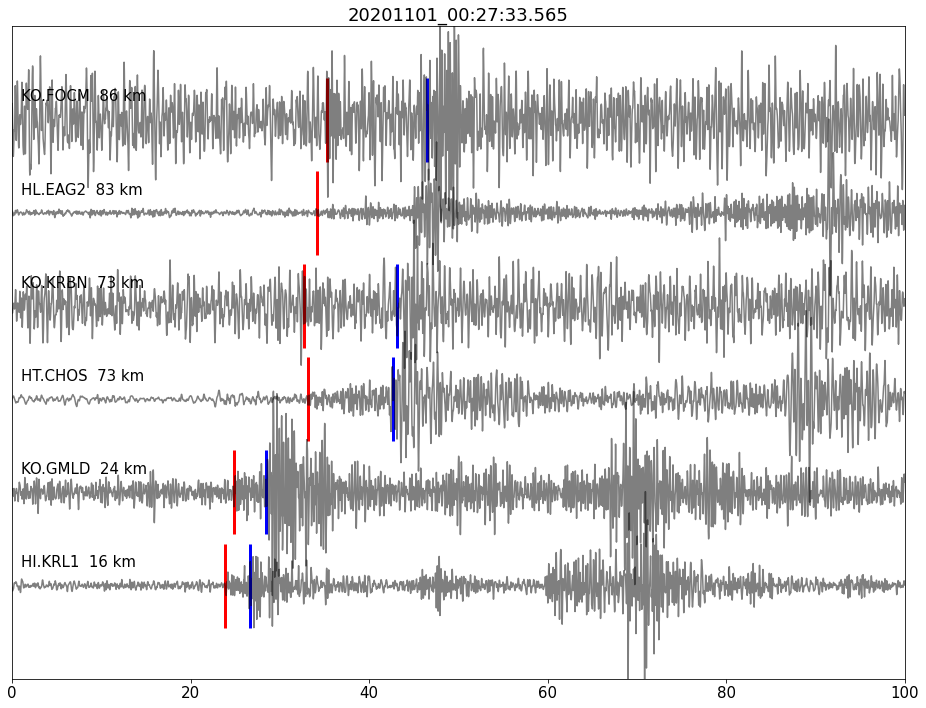

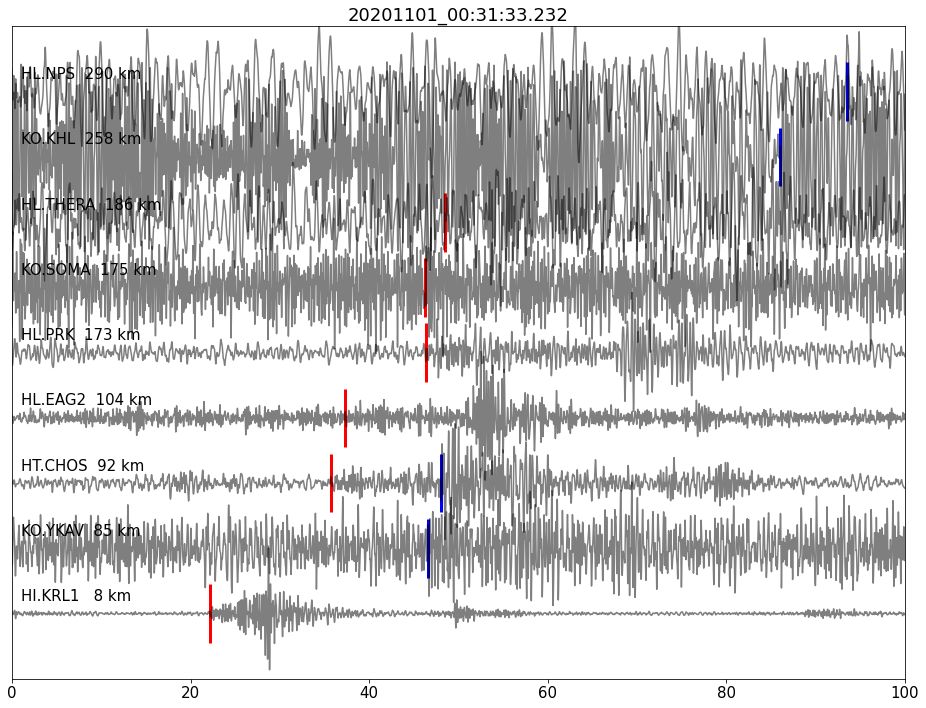

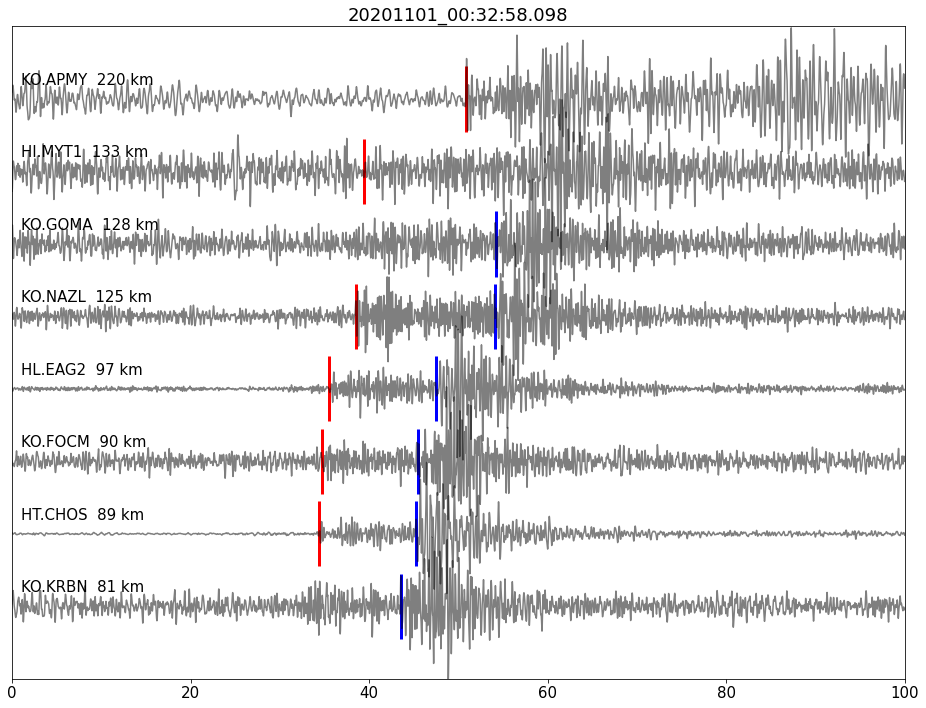

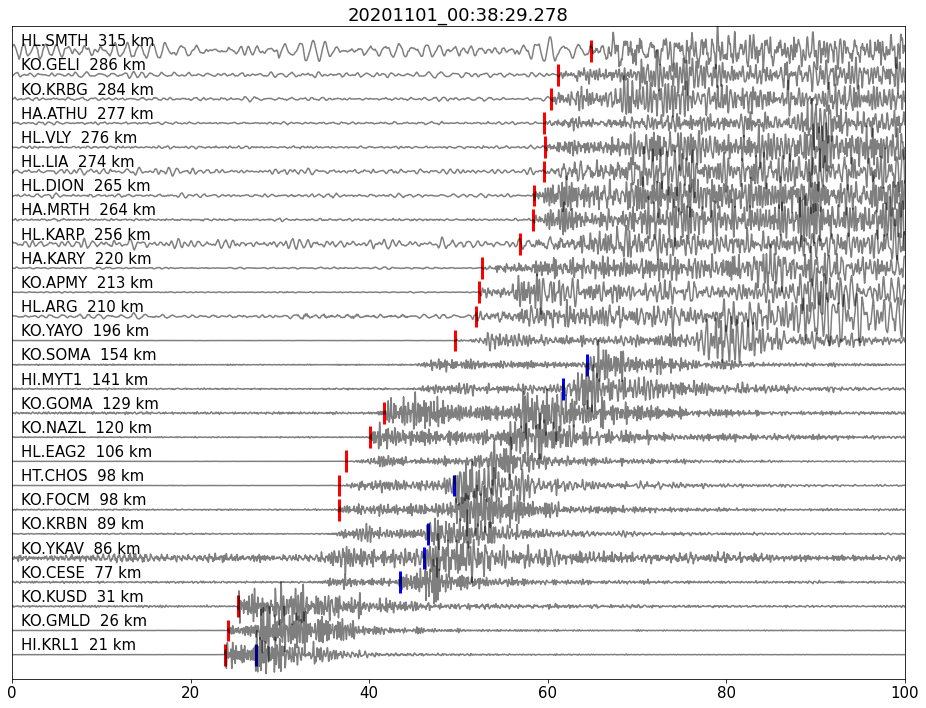

...

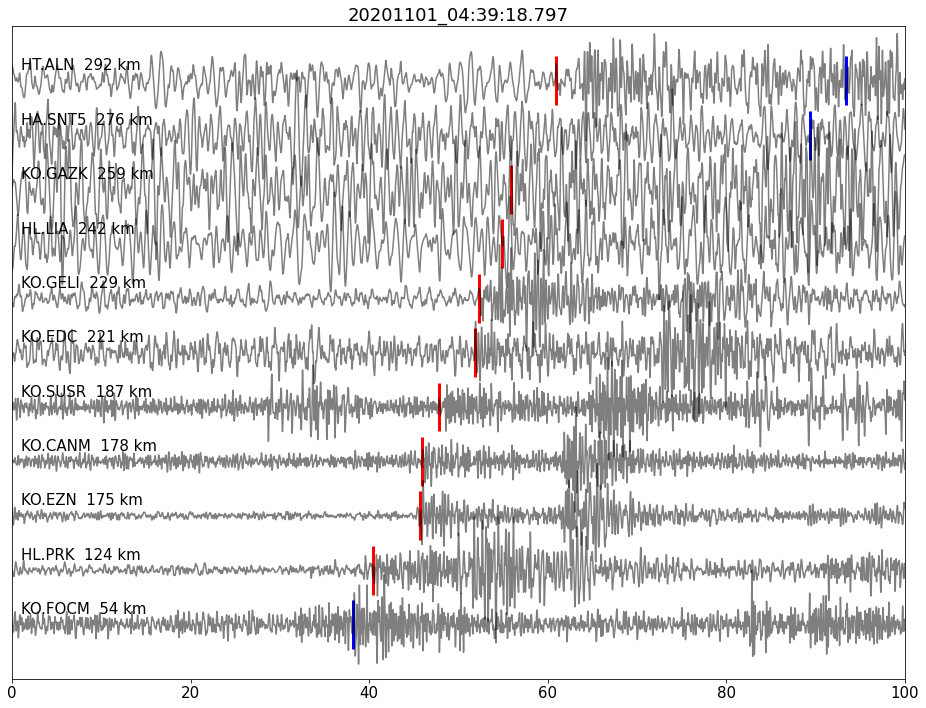

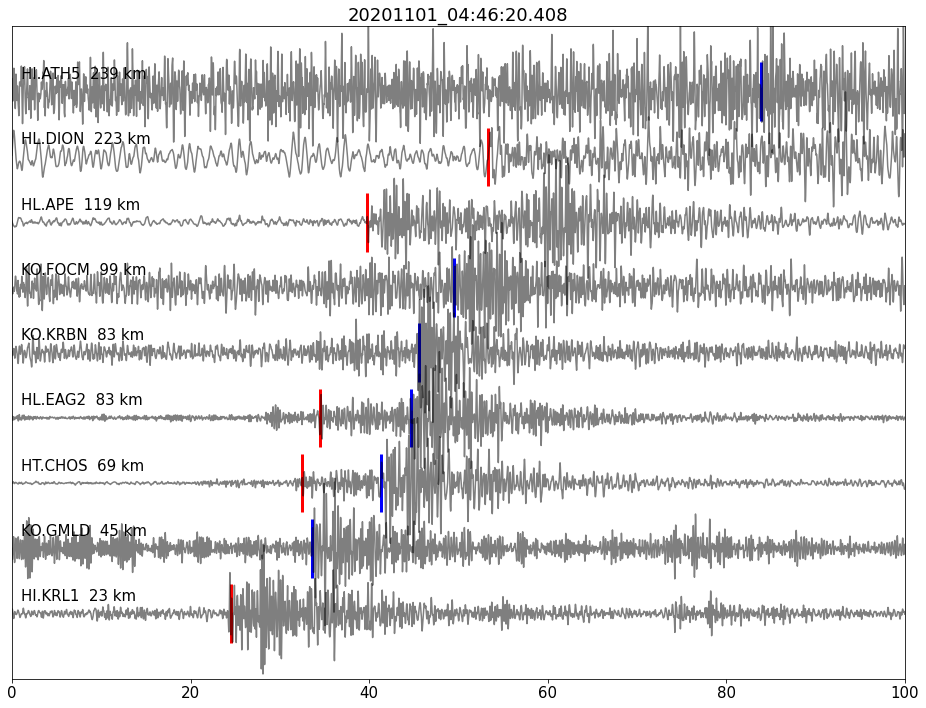

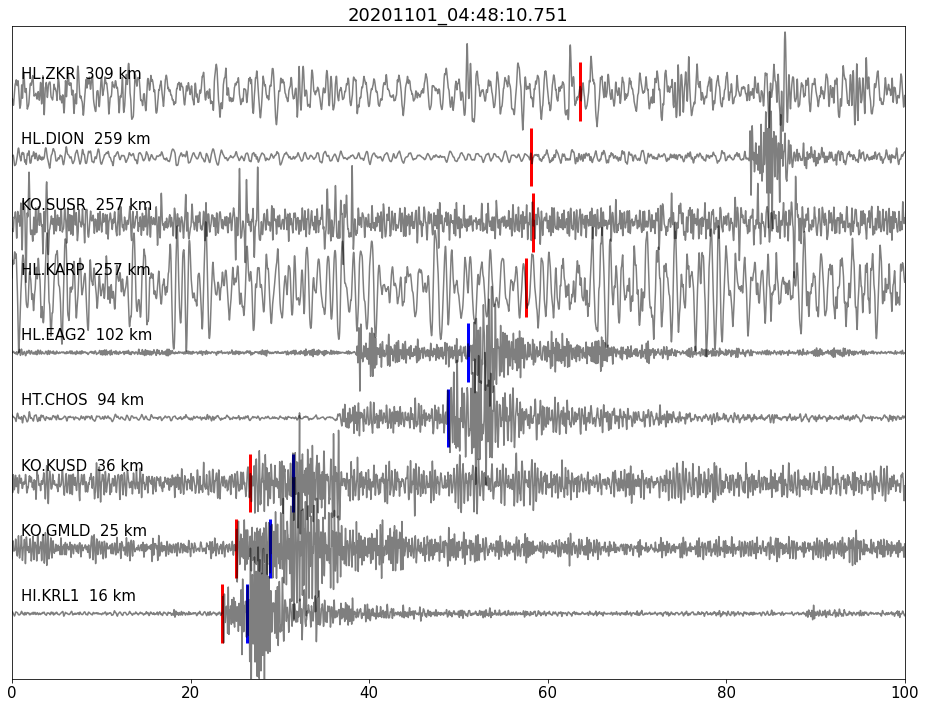

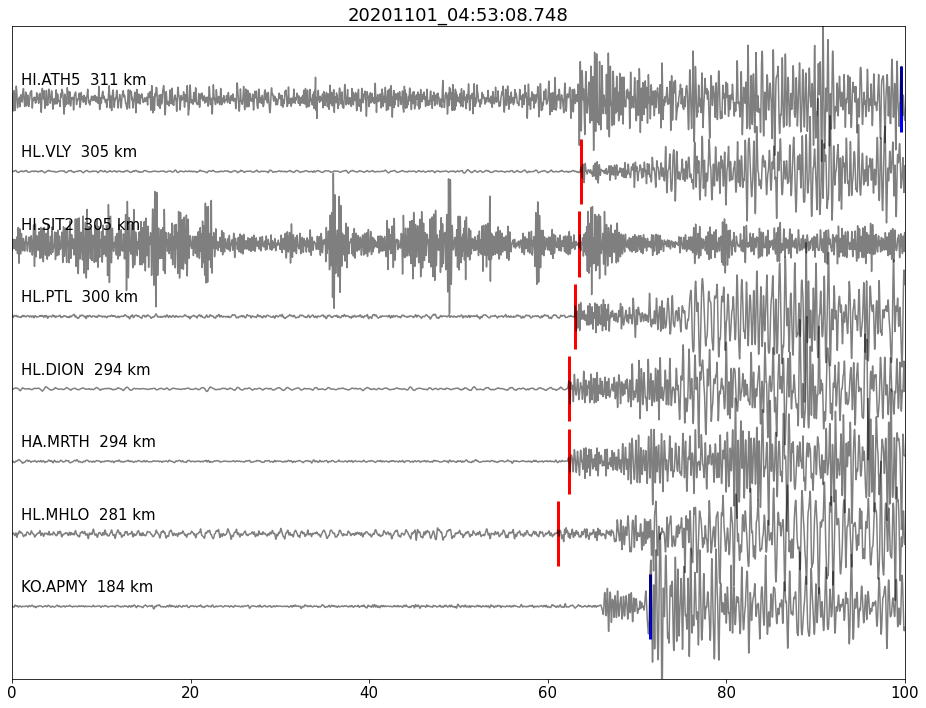

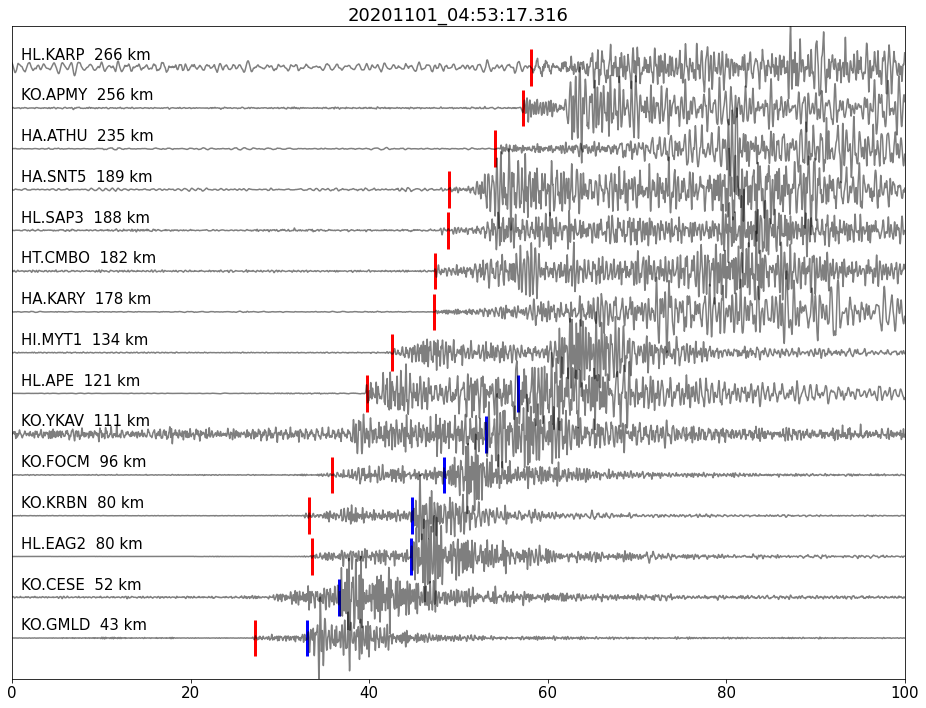

<Figure size 1152x864 with 0 Axes>

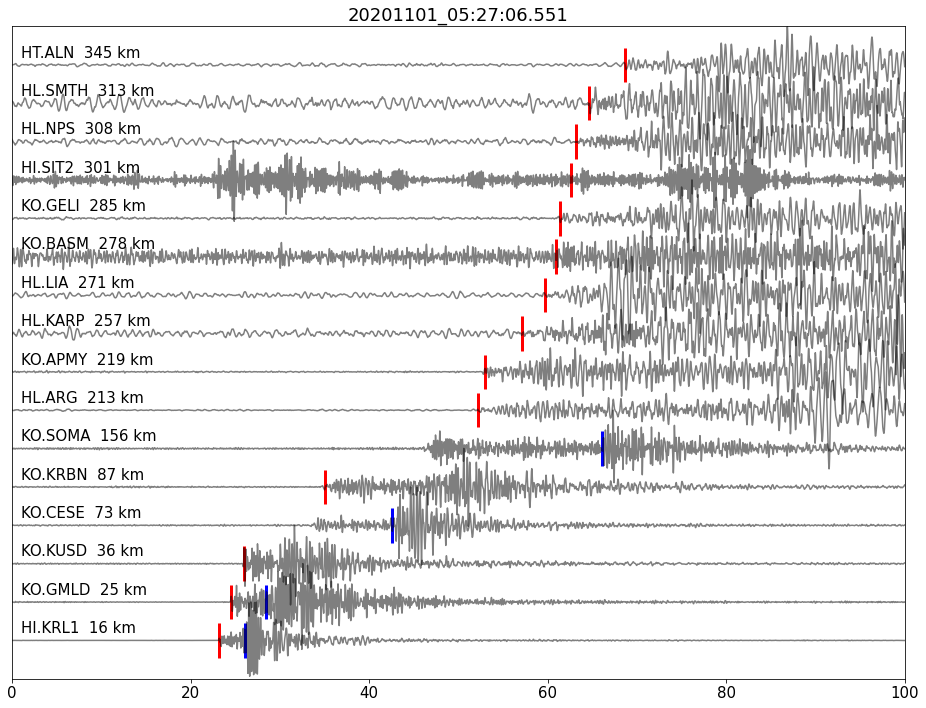

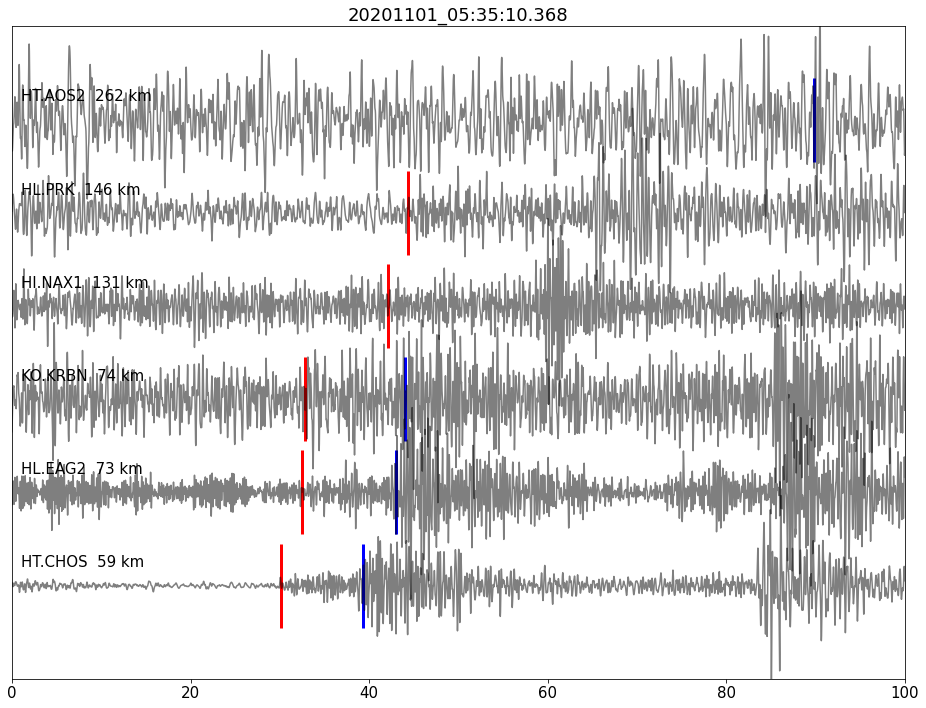

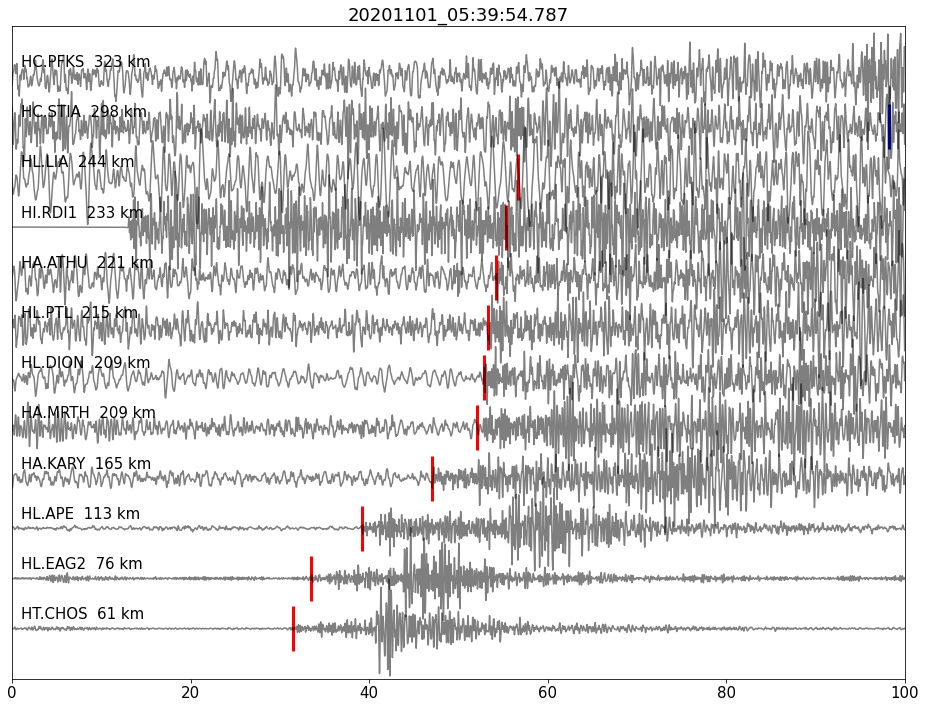

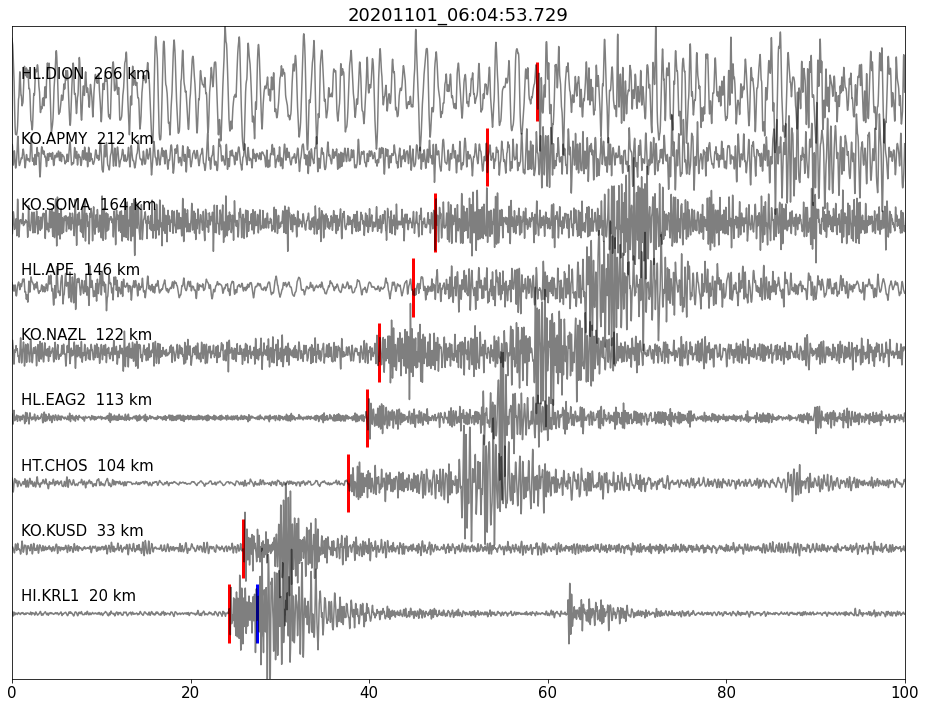

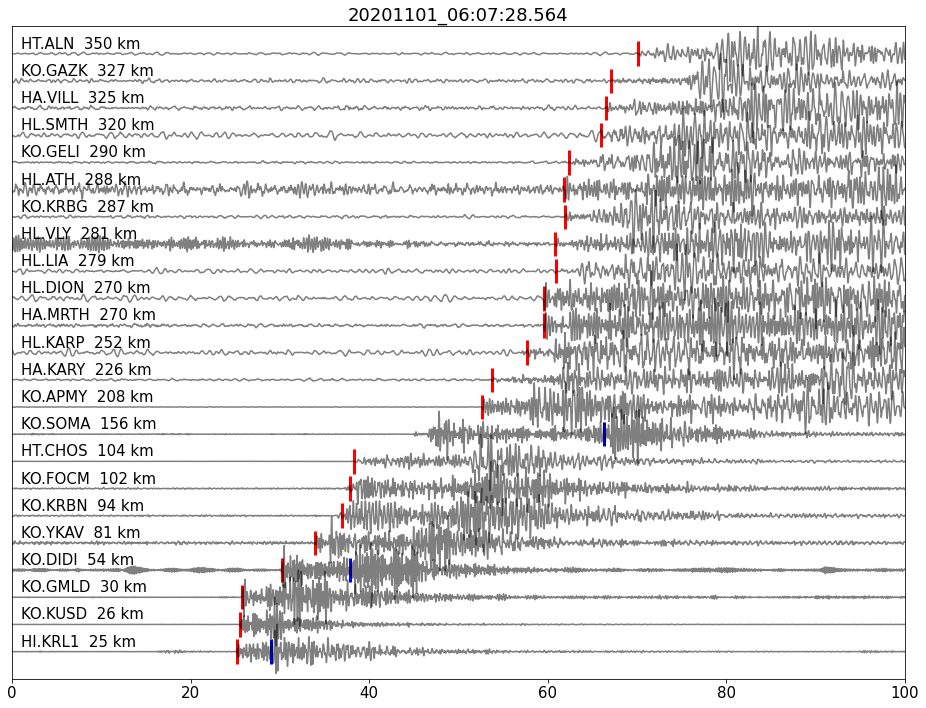

...

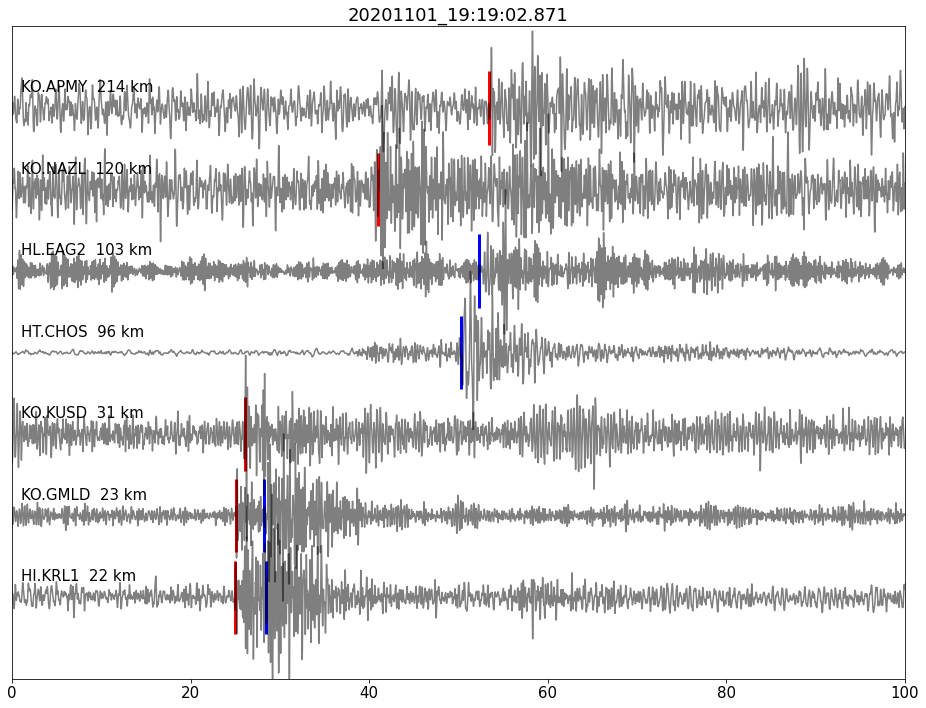

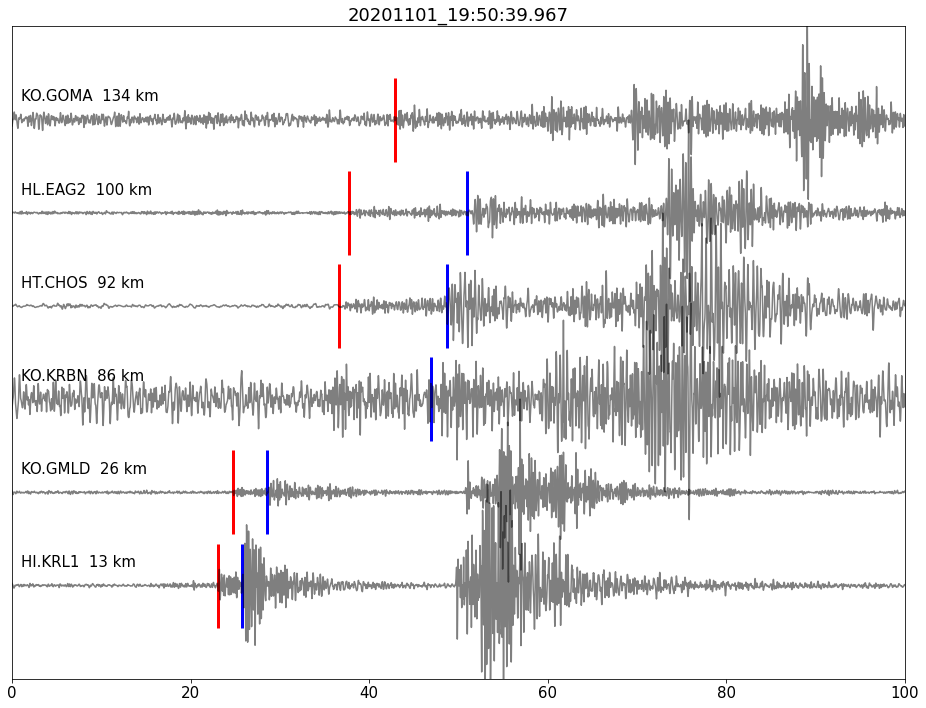

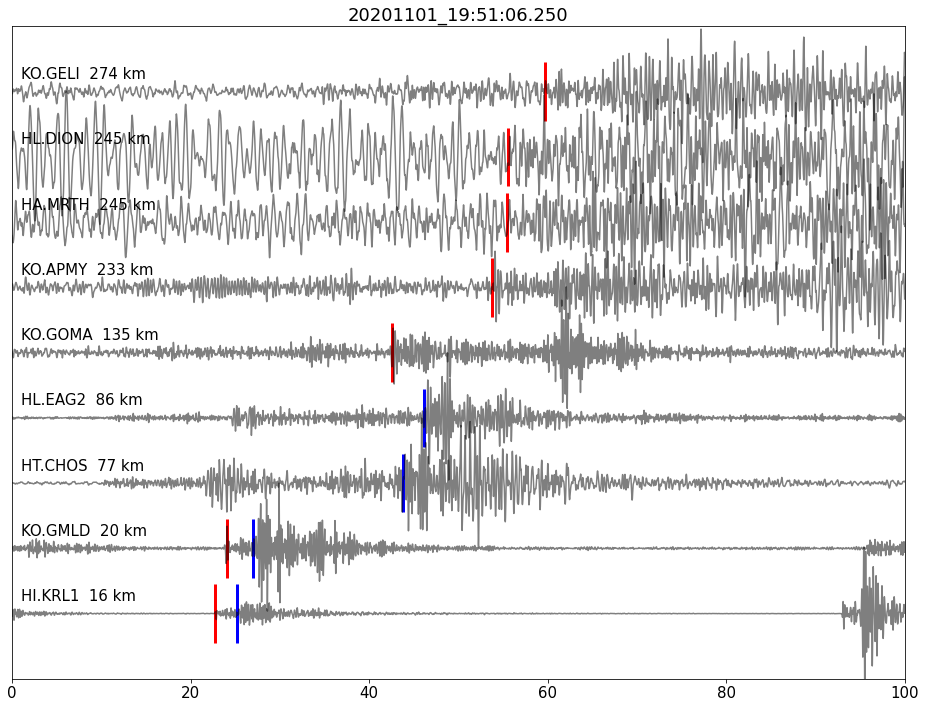

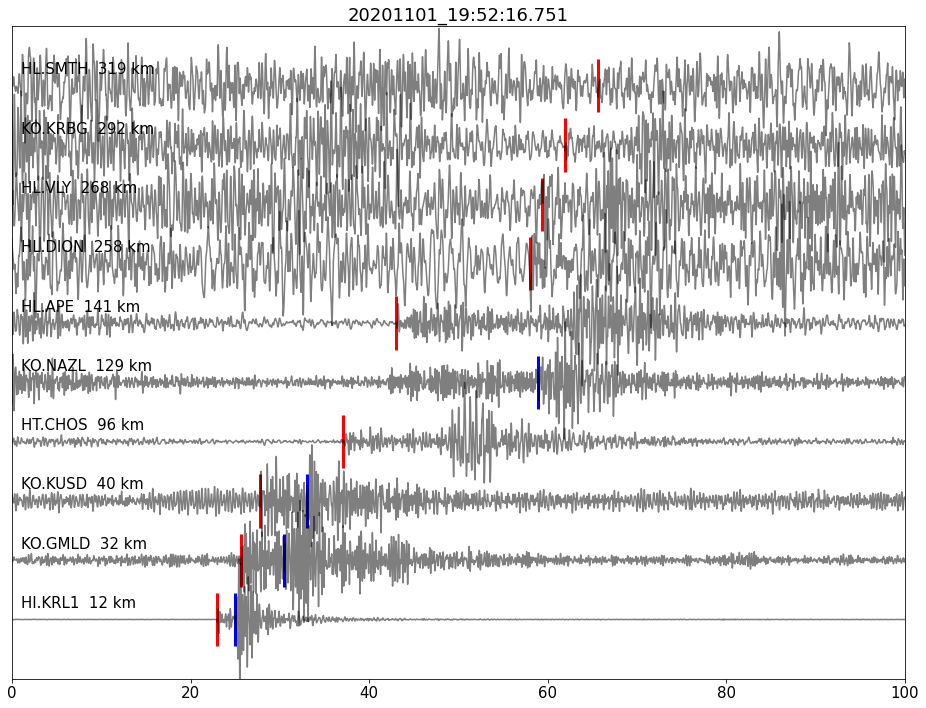

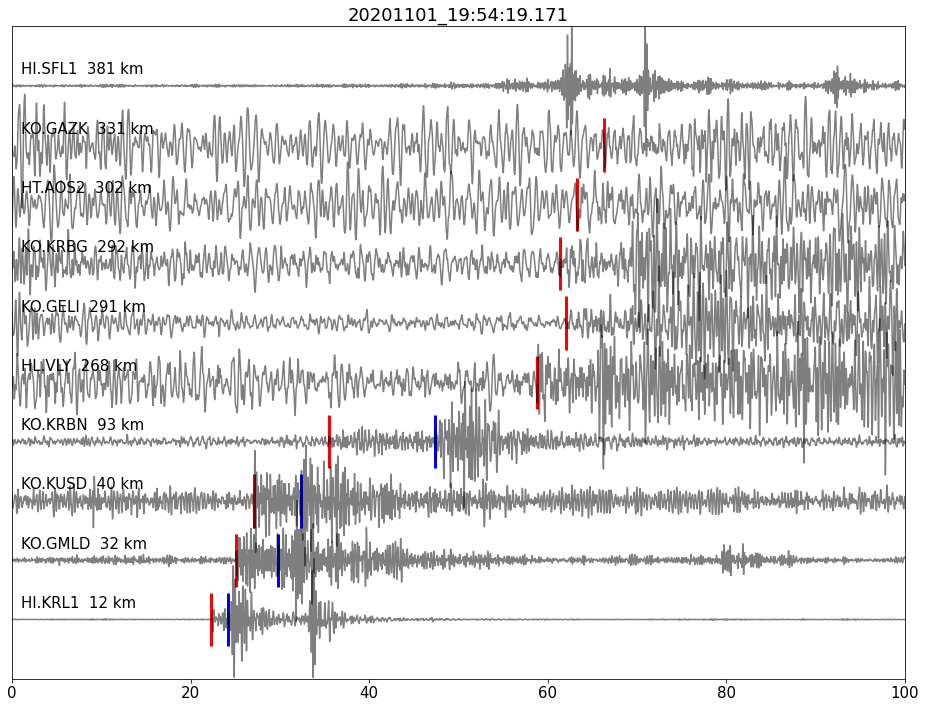

<Figure size 1152x864 with 0 Axes>

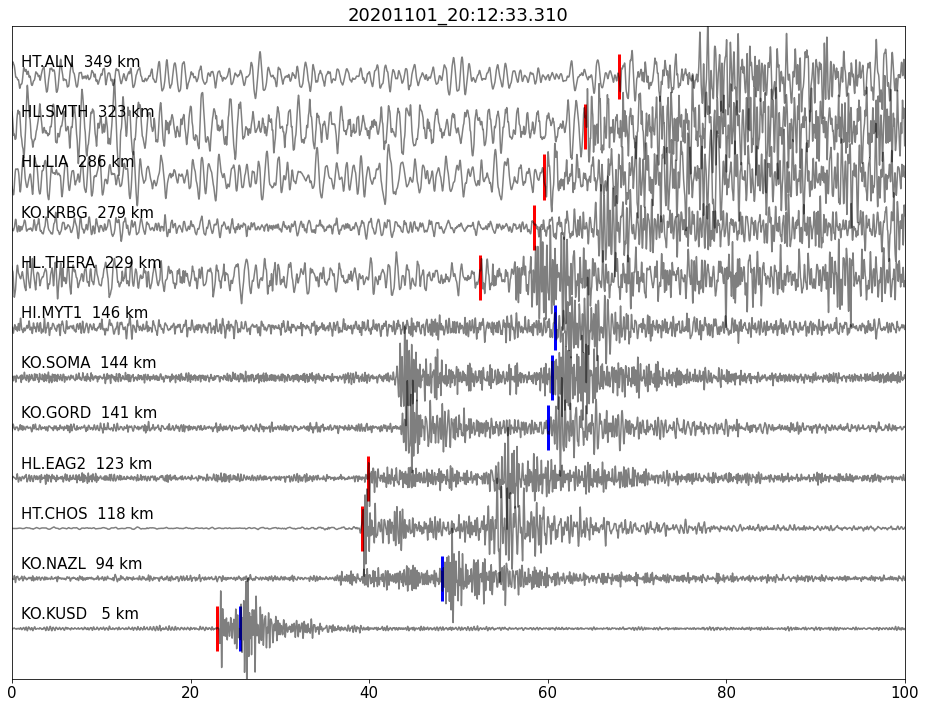

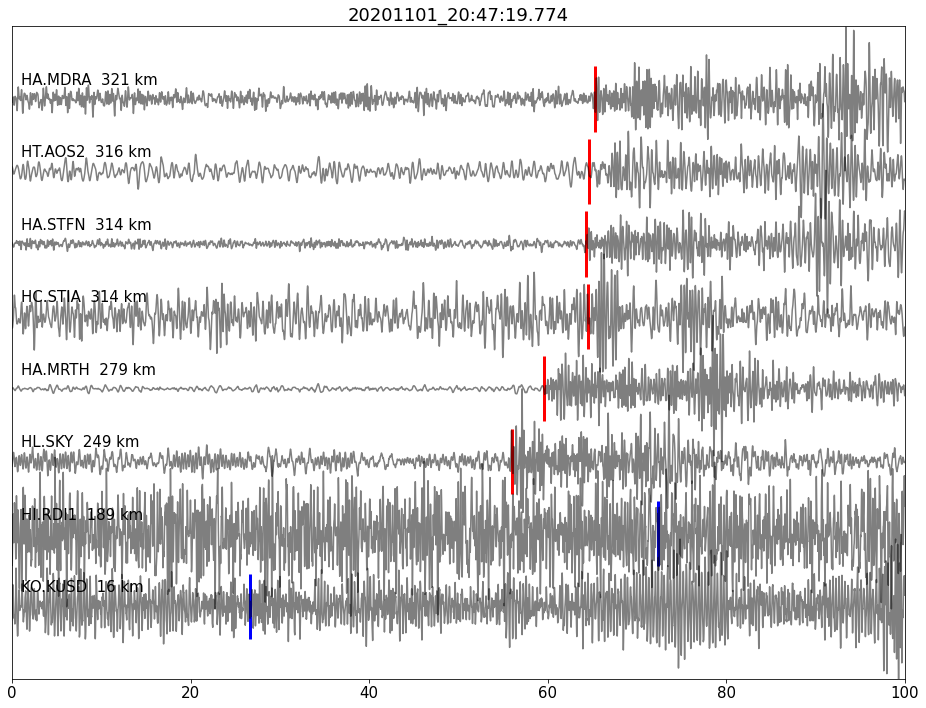

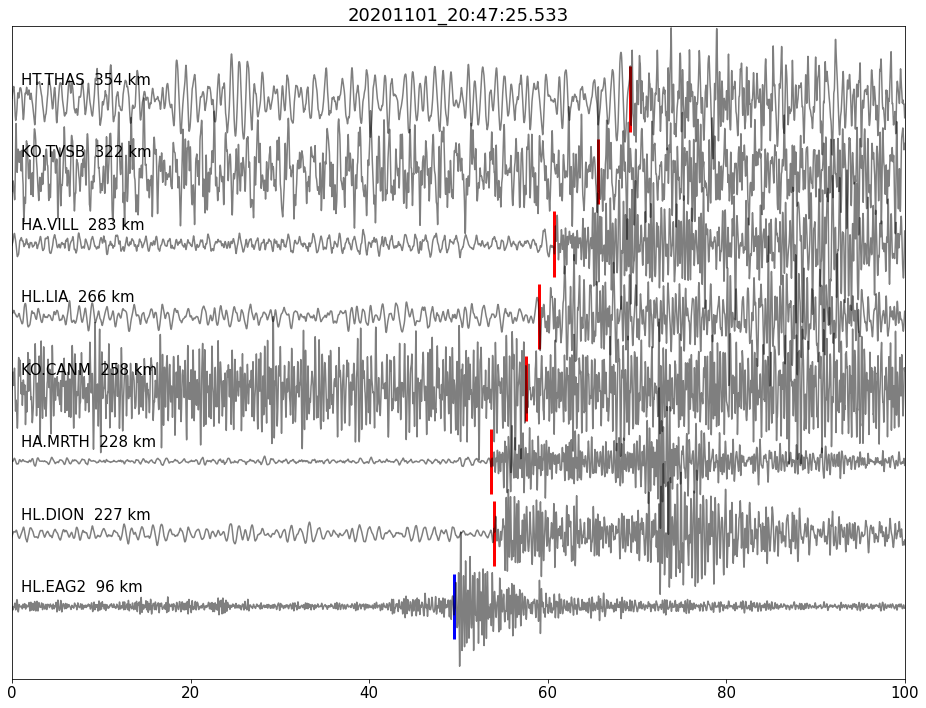

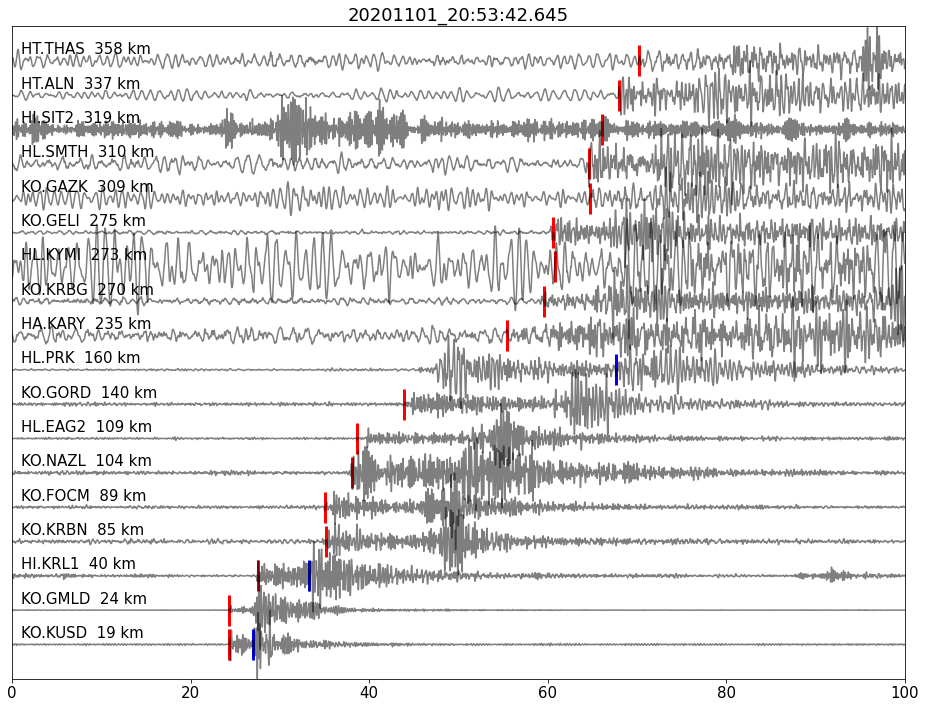

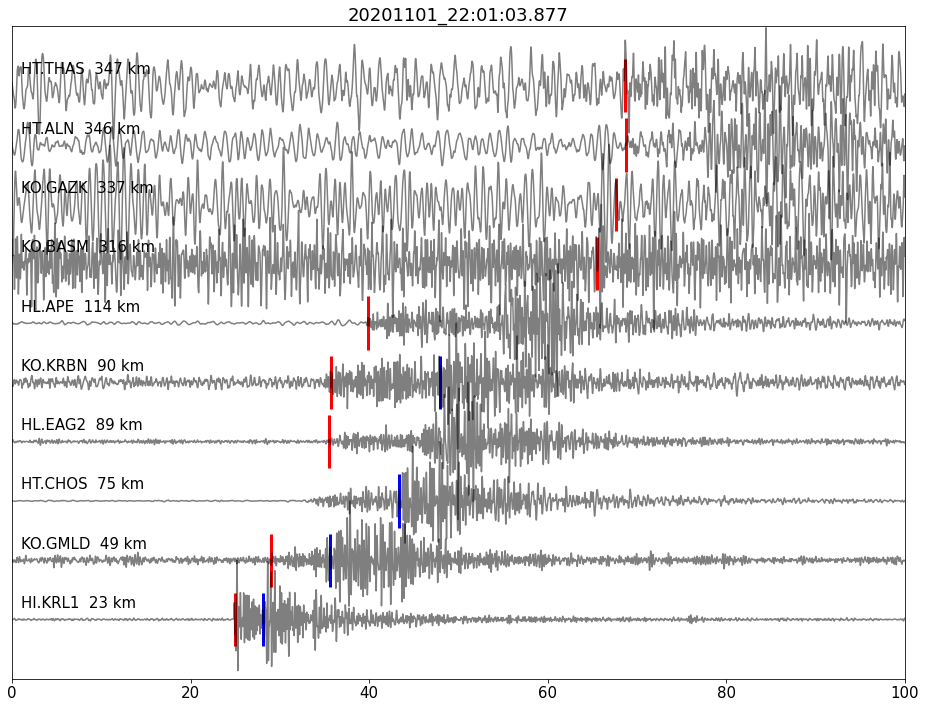

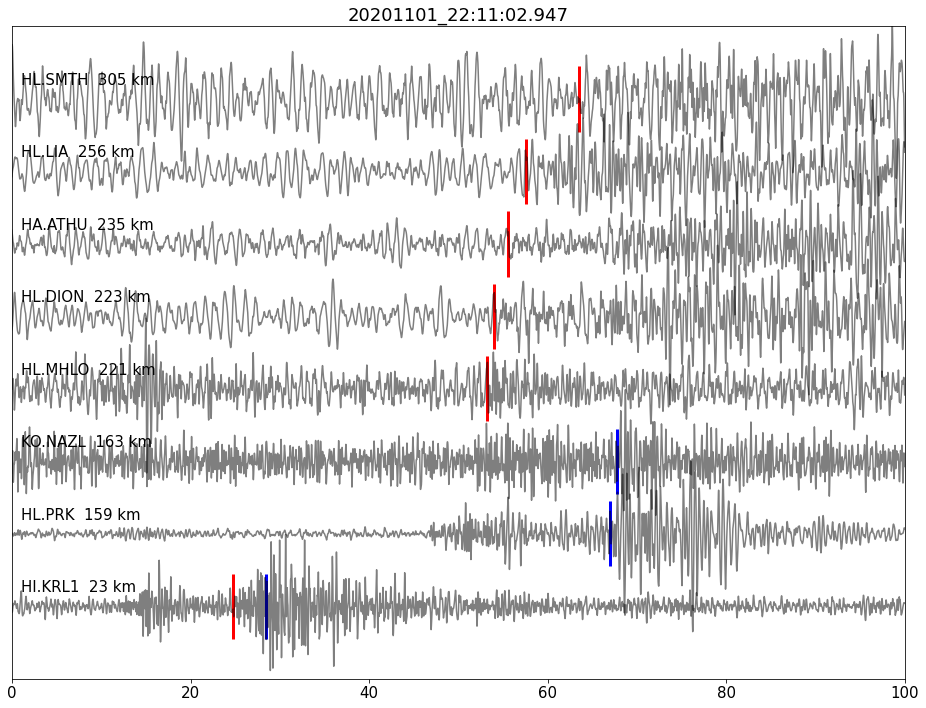

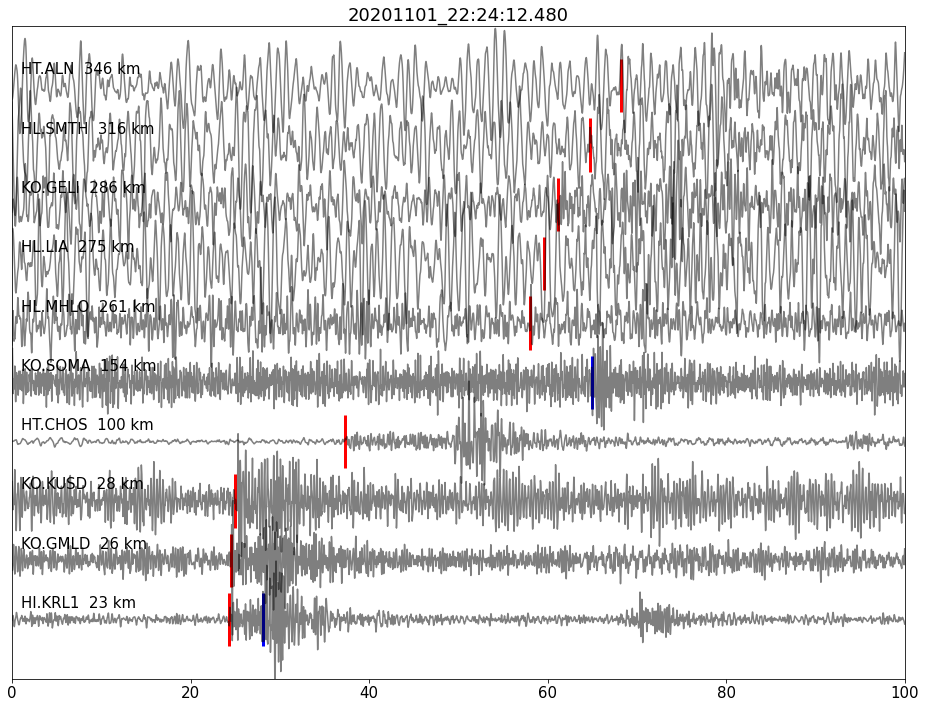

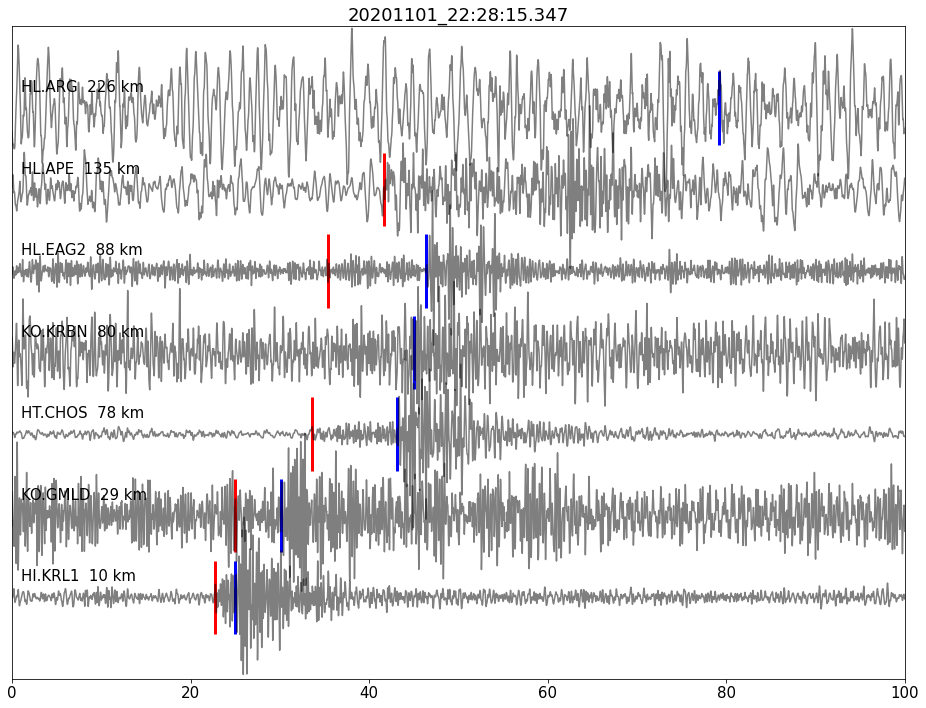

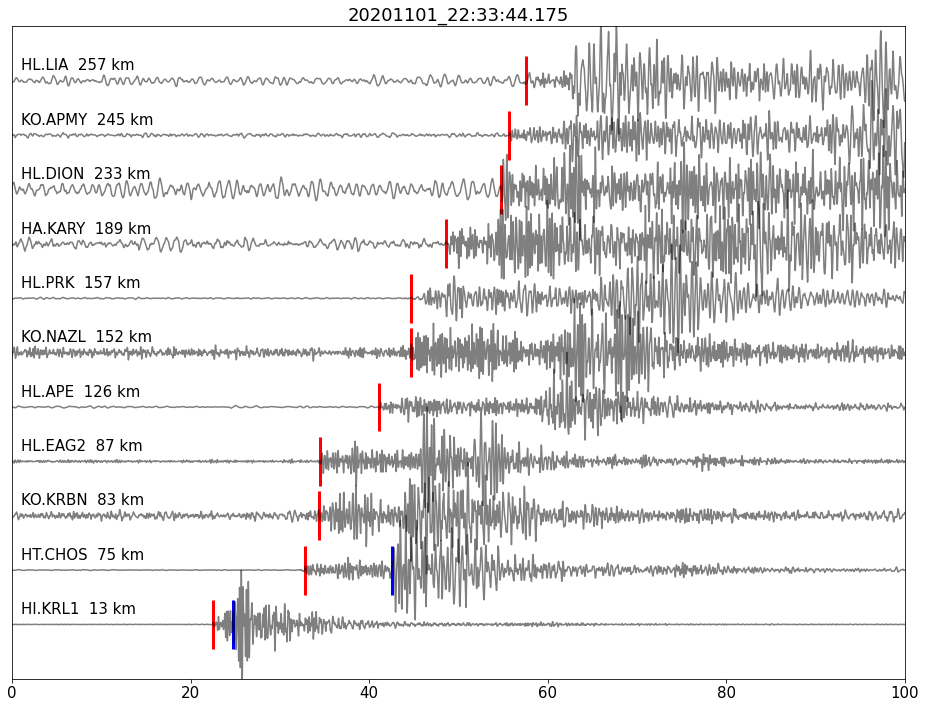

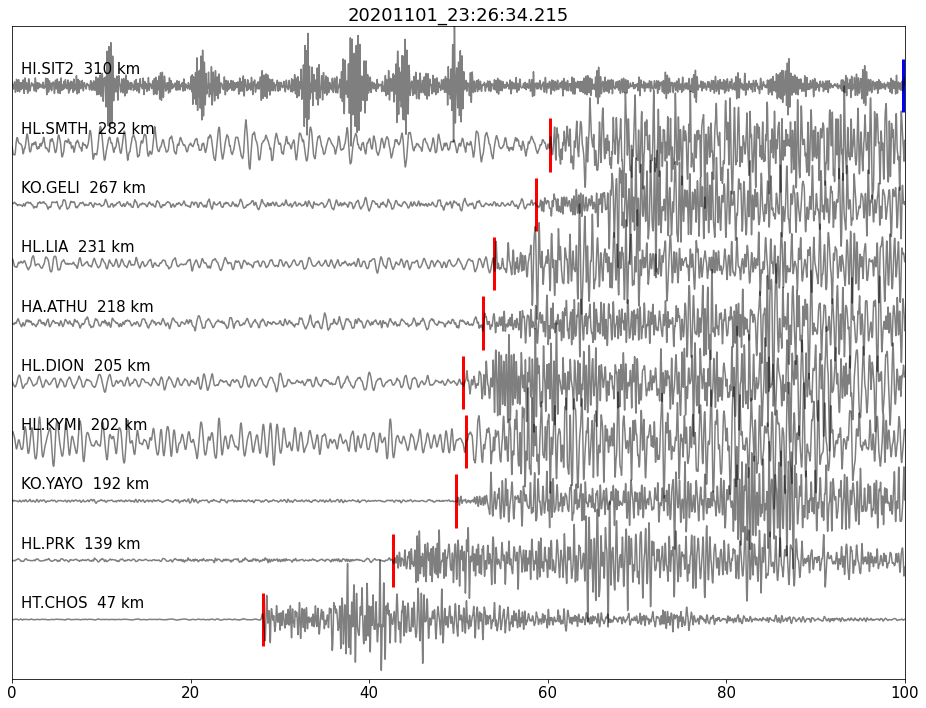

In [4]:
sta_dict={}
for i in range(len(full_sta)):
    sta_dict[full_sta['network'][i]+'.'+full_sta['station'][i]]=(full_sta['latitude'][i], full_sta['longitude'][i])


def plot_waveforms(waveforms, phases,sta_dict,La_foreshock, Lo_foreshock, origin_time,time):
    sort_list=[]
    for i in waveforms: 
        
        dis,_,_=gps2dist_azimuth(La_foreshock , Lo_foreshock,  sta_dict[i][0],    sta_dict[i][1])
        sort_list.append((i,dis/1000))
    sort_list.sort(key = lambda x : x[1])

    plt.figure(figsize=(16,12))
    barlength=0.45
    for k,i in enumerate(sort_list): 
        waveform = waveforms[i[0]]
        plt.plot(np.arange(length)/100,(waveform[:,2]-waveform[:,2].mean())/waveform[:,2].max()+k,'k',alpha=0.5)  
        for phase in phases[i[0]]:
            if phase[0] == 'P':
                plt.vlines(float(phase[1])-origin_time,k-barlength,k+barlength,'r',lw=3)
            else:
                plt.vlines(float(phase[1])-origin_time,k-barlength,k+barlength,'b',lw=3)
        plt.text(1,k+0.2,i[0]+'  %2.f km' %i[1])
        plt.xlim([0,100])
        plt.ylim([-1,len(sort_list)])
        plt.yticks([])
        plt.title(time)
        plt.savefig('new_detect/'+time+'.png')
        
        
flag = 0
length = 10000
folder = '20201102'
import csv
with open('REAL_result_phase4/phase_sel_'+folder+'.txt', 'r') as f:
    df= csv.reader(f,delimiter=' ', skipinitialspace=True)
    
    for ind, record in enumerate(df):
#         print(record)
        if len(record) != 9:            
            if flag:
                plot_waveforms(waveforms, phases, sta_dict, lat, lon, origin_time,time)
            time = ''.join(record[1:4])+'_'+record[4]
            origin_time = int(float(record[5]))-20
            lat = float(record[7])
            lon = float(record[8])
            print(origin_time)
            hour=origin_time//3600+1
            origin_time2=origin_time%3600

            waveforms = {}
            phases = {}        
            flag = 1
            continue
        if record[0]+'.'+record[1] in phases:
            phases[record[0]+'.'+record[1]].append((record[2],record[3]))
        else:
            waveform = np.zeros((length,3))
            
            file = 'conti_data/'+folder+'/'+str(hour)+'h/'+record[0]+'_'+record[1]+'.mseed'
            print(file)
            st = read(file)
            st.detrend()
            st.filter('bandpass',freqmin=0.5, freqmax=5)
            st.detrend()
            try:
                for i in range(3):
                    waveform[:length,i]=st[i].data[origin_time2*100:origin_time2*100+length]
            except:
                continue
            phases[record[0]+'.'+record[1]]=[(record[2],record[3])]
            waveforms[record[0]+'.'+record[1]]=waveform
            
            
plot_waveforms(waveforms, phases, sta_dict, lat, lon, origin_time,time)